<a href="https://colab.research.google.com/github/Visna-dp/AlfaCampus/blob/main/final/income_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Прогноз дохода клиентов

https://www.kaggle.com/competitions/income-prediction-alfa-campus/overview

Сергеева Дарья

## Описание задачи

Данное соревнование являлось итоговым проектом в рамках курса [Прикладной Data Science в финтехе](https://alfa-campus.ru/ds-fintech), организованного Альфа Банком.

Задача прогнозирования дохода имеет особенное значение в Банке.
Эта информация помогает точнее и более релевантно подбирать продукты и условия их приобретения, что в свою очередь вносит существенный вклад в прибыль Банка.
Помимо ценности для Банка, оценка дохода является регуляторным требованием ЦБ в части расчета предельно допустимой кредитной нагрузки для клиента.

Бизнес-задача: спрогнозировать доход клиента за определенный месяц.

Техническая задача для специалиста в Data Science: построить модель машинного обучения, которая на основе предложенных характеристик клиента будет предсказывать числовой признак - доход клиента.

## Импорт библиотек

In [74]:
%%capture
!pip install catboost
!pip install optuna
!pip install category_encoders

In [75]:
import numpy as np # linear algebra
import pandas as pd
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold
from sklearn.metrics import precision_recall_curve, auc
from sklearn.metrics import classification_report
from sklearn.ensemble import StackingRegressor
from sklearn.preprocessing import LabelEncoder, MinMaxScaler

from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from category_encoders import CatBoostEncoder

from scipy import stats

from catboost import Pool
from catboost import CatBoostClassifier
from catboost import CatBoostRegressor

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import Input, Embedding, Concatenate, Dense, Reshape, LSTM, SpatialDropout1D
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import ModelCheckpoint

import warnings
warnings.filterwarnings('ignore')

In [76]:
# если работаем в колабе, подключаем гугл диск
from google.colab import drive
drive.mount('/content/drive')

FILE_PATH = '/content/drive/MyDrive/SF_DS/data_income/'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Функции

In [77]:
# функция для расчета метрики WMAE
def weighted_mean_absolute_error(y_true, y_pred, weights):

    '''

    Weighted mean absolute error.

    Parameters
    ----------
    y_true: ndarray
        Ground truth
    y_pred: ndarray
        Array of predictions

    Returns
    -------
    rmsle: float
        Weighted mean absolute error

    References
    ----------
    .. [1] https://kaggle-metrics.readthedocs.io/en/latest/_modules/kaggle_metrics/regression.html

    '''

    return (weights * np.abs(y_true - y_pred)).mean()

## Знакомство с данными, базовый анализ и генерация новых признаков.

In [78]:
train_df = pd.read_csv(
    FILE_PATH+'train.csv',
    sep=";",
    decimal=",",
    encoding="windows-1251"
)
test_df = pd.read_csv(
    FILE_PATH+'test.csv',
    sep=";",
    decimal=",",
    encoding="windows-1251"
)
train_df.shape, test_df.shape

((205962, 235), (37183, 233))

In [79]:
train_df.head()

,client_id,feature_date,target,w,accum_rur_amt_cm_avg_div_v2,addrref,amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__bilety_na_kontserty_i_v_teatry,amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__brokerskie_uslugi,amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__hosting,amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__spa_sauny_bani,...,unique_countries1,vcu_other_rate_max_2avg_prop,voc_features_12m_voc_without_marks_portion,voc_features_36m_mark_eq_1_flag,voc_features_36m_max_mark,voc_features_full_mark_eq_3_flag,worksalary_rur_amt,brand,model,productionyear
0,0,2023-06-30,150000.000000,0.681495,0.0,Свердловская область,NaN,NaN,NaN,NaN,...,NaN,NaN,0.947368,1.0,5.0,0.0,NaN,NaN,NaN,NaN
1,1,2023-01-31,96845.573333,0.085636,1.0,Новосибирская область,NaN,NaN,NaN,NaN,...,NaN,NaN,1.000000,0.0,NaN,0.0,NaN,NaN,NaN,NaN
2,2,2023-03-31,60906.061667,0.317245,1.0,Новосибирская область,NaN,NaN,NaN,NaN,...,NaN,NaN,1.000000,1.0,1.0,0.0,NaN,NaN,NaN,NaN
3,3,2023-02-28,65272.380000,0.268299,1.0,Московская область,NaN,NaN,NaN,NaN,...,NaN,NaN,0.823529,0.0,5.0,0.0,NaN,NaN,NaN,NaN
4,4,2023-05-31,43999.770000,0.506764,1.0,Краснодарский край,NaN,NaN,NaN,NaN,...,NaN,1.104,1.000000,0.0,NaN,0.0,NaN,NaN,NaN,NaN


Тренировочные данные содержат более 200 000 строк и 233 признака.
 - 'client_id' - id клиента, уникален для каждой записи,
 - 'feature_date' - дата сбора признаков - последний день месяца, за который выполняется прогноз,
 - 'target' - целевая переменная,
 - 'w' - веса для расчета метрики WMAE

Описание всех признаков можно увидеть в файле [description](https://www.kaggle.com/competitions/income-prediction-alfa-campus/data?select=description.xlsx)

In [80]:
train_df['feature_date'] = pd.to_datetime(train_df['feature_date'])
test_df['feature_date'] = pd.to_datetime(test_df['feature_date'])
train_df['feature_date'].describe()

count                  205962
unique                     12
top       2023-05-31 00:00:00
freq                    37640
first     2022-09-30 00:00:00
last      2023-08-31 00:00:00
Name: feature_date, dtype: object

In [81]:
test_df['feature_date'].describe()

count                   37183
unique                      1
top       2023-09-30 00:00:00
freq                    37183
first     2023-09-30 00:00:00
last      2023-09-30 00:00:00
Name: feature_date, dtype: object

Данные предоставлены за период с 30-09-2022 по 31-08-2023, прогноз необходимо сделать на дату 30-09-2023

In [82]:
train_df.describe(include='object')

,addrref,bki_total_ip_max_limit,hdb_bki_active_cc_cnt,hdb_bki_active_ip_max_outstand,hdb_bki_active_micro_max_outstand,hdb_bki_active_pil_max_overdue,hdb_bki_other_active_auto_month_payments_sum,hdb_bki_total_cc_max_limit,hdb_bki_total_ip_cnt,hdb_bki_total_max_limit,...,hdb_bki_total_pil_max_limit,main_last_position_ccode,main_pre_last_position_ccode,oldest_campaignsegment_ccode_for_nss,oldest_campaignsegment_ccode_for_pil,part_last_position_ccode,part_pre_last_position_ccode,segment,brand,model
count,179914,5093,179874,45962,12420,113513,5631,171141,179874,179874,...,166624,30398,23648,123425,142384,5535,3694,169609,8623,8658
unique,59,2763,60,43267,5458,24365,3533,9991,15,52263,...,54202,9207,5192,56,13,1236,1325,3,422,2397
top,г. Москва,3000000.0,2.0,0.0,0.0,0.0,0.0,100000.0,0.0,300000.0,...,300000.0,БЕЗРАБОТНЫЙ,БЕЗРАБОТНЫЙ,ACFYN_NZP,PIL2PIL,БЕЗРАБОТНЫЙ,БЕЗРАБОТНЫЙ,Mass Affluent,ВАЗ,БЕЗ МОДЕЛИ
freq,63973,135,23967,1592,4254,86602,1812,7356,117552,2345,...,3313,2872,10525,77486,45195,2718,686,76394,531,141


Преобразуем признаки, полученные из БКИ, в числовые.

In [83]:
train_df[train_df.filter(like='bki').columns] = train_df[train_df.filter(like='bki').columns].astype(float)
test_df[train_df.filter(like='bki').columns] = test_df[train_df.filter(like='bki').columns].astype(float)

In [84]:
basic_col = ['client_id', 'feature_date', 'target', 'w']

cat_feat = [col for col in train_df.columns if (col not in basic_col) and (train_df[col].dtype.name=='object')]
#cat_feat += ['year']
num_feat = [col for col in train_df.columns if (col not in basic_col) and (col not in cat_feat)]
len(cat_feat), len(num_feat)

(10, 221)

Посмотрим распределение доли пропущенных значений на трейне и тесте.

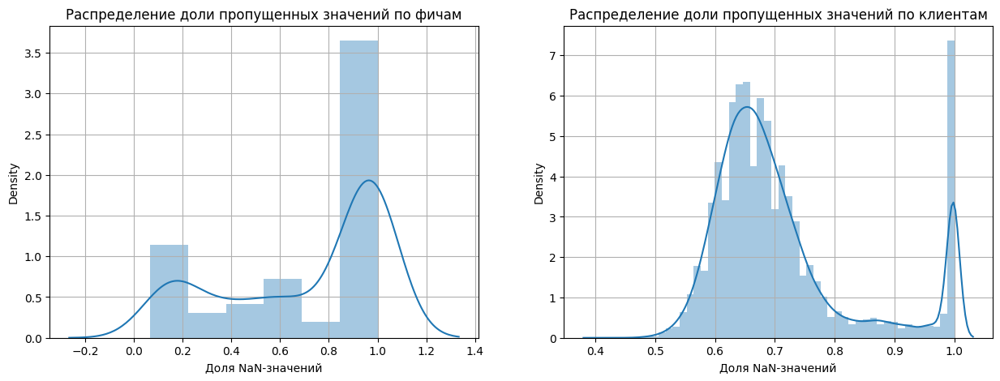

In [85]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

sns.distplot(train_df[cat_feat+num_feat].isna().mean(axis=0), ax=ax[0])
ax[0].set_title('Распределение доли пропущенных значений по фичам')
ax[0].set_xlabel('Доля NaN-значений')
ax[0].grid(True)

sns.distplot(train_df[cat_feat+num_feat].isna().mean(axis=1), ax=ax[1])
ax[1].set_title('Распределение доли пропущенных значений по клиентам')
ax[1].set_xlabel('Доля NaN-значений')
ax[1].grid(True)

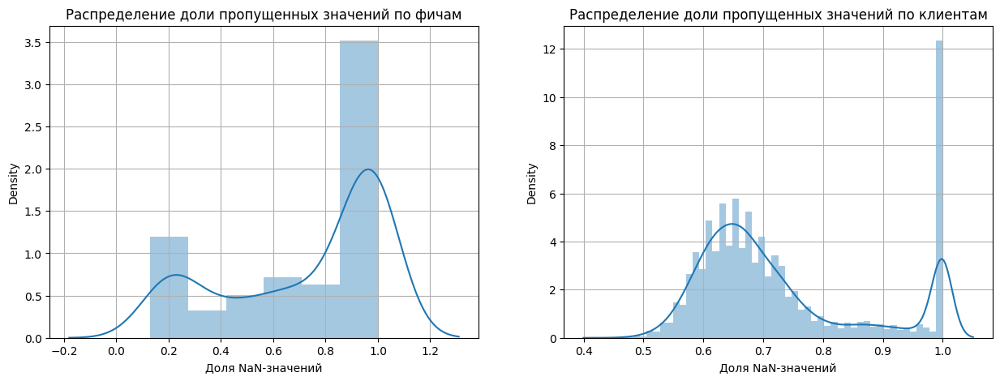

In [86]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

sns.distplot(test_df[cat_feat+num_feat].isna().mean(axis=0), ax=ax[0])
ax[0].set_title('Распределение доли пропущенных значений по фичам')
ax[0].set_xlabel('Доля NaN-значений')
ax[0].grid(True)

sns.distplot(test_df[cat_feat+num_feat].isna().mean(axis=1), ax=ax[1])
ax[1].set_title('Распределение доли пропущенных значений по клиентам')
ax[1].set_xlabel('Доля NaN-значений')
ax[1].grid(True)

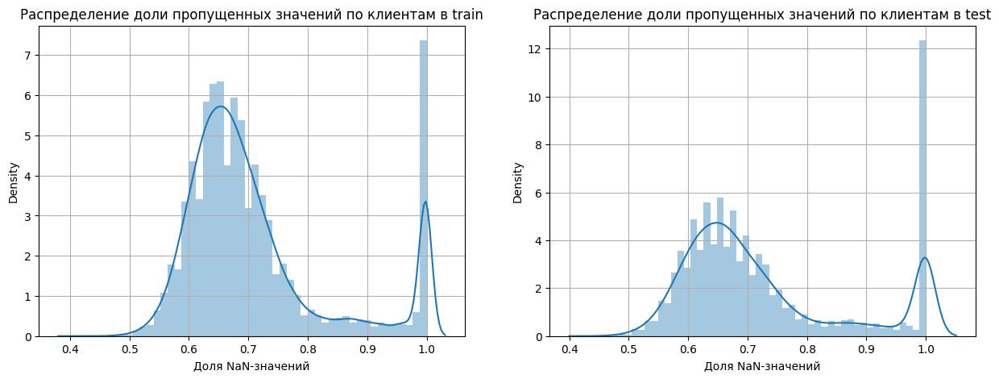

In [87]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

sns.distplot(train_df[cat_feat+num_feat].isna().mean(axis=1), ax=ax[0])
ax[0].set_title('Распределение доли пропущенных значений по клиентам в train')
ax[0].set_xlabel('Доля NaN-значений')
ax[0].grid(True)

sns.distplot(test_df[cat_feat+num_feat].isna().mean(axis=1), ax=ax[1])
ax[1].set_title('Распределение доли пропущенных значений по клиентам в test')
ax[1].set_xlabel('Доля NaN-значений')
ax[1].grid(True)

Видим, что в датасете присутствует много пропусков, как по фичам, так и по клиентам. Создадим признак с долей пропущенных значений.

In [88]:
train_df['nan_rate'] = train_df[cat_feat+num_feat].isna().mean(axis=1)
test_df['nan_rate'] = test_df[cat_feat+num_feat].isna().mean(axis=1)

Посмотрим внимательней на признаки для должностей.

In [89]:
train_df[train_df.filter(like='position').columns].describe()

,main_last_position_ccode,main_pre_last_position_ccode,part_last_position_ccode,part_pre_last_position_ccode
count,30398,23648,5535,3694
unique,9207,5192,1236,1325
top,БЕЗРАБОТНЫЙ,БЕЗРАБОТНЫЙ,БЕЗРАБОТНЫЙ,БЕЗРАБОТНЫЙ
freq,2872,10525,2718,686


In [90]:
train_df['main_last_position_ccode'].value_counts().head(10)

БЕЗРАБОТНЫЙ             2872
Генеральный директор     483
Менеджер                 431
Директор                 385
Продавец-кассир          345
Главный бухгалтер        277
Директор магазина        275
Менеджер по продажам     268
Начальник отдела         253
Специалист               251
Name: main_last_position_ccode, dtype: int64

In [91]:
train_df['main_last_position_ccode'].value_counts().head(30).index

Index(['БЕЗРАБОТНЫЙ', 'Генеральный директор', 'Менеджер', 'Директор',
       'Продавец-кассир', 'Главный бухгалтер', 'Директор магазина',
       'Менеджер по продажам', 'Начальник отдела', 'Специалист', 'Кладовщик',
       'Водитель автомобиля', 'Водитель-экспедитор', 'Администратор',
       'Ведущий менеджер', 'Ведущий специалист', 'Главный специалист',
       'Бухгалтер', 'Заместитель руководителя',
       'Специалист по доставке пластиковых карт', 'Грузчик',
       'Специалист по предотвращению потерь', 'ГЕНЕРАЛЬНЫЙ ДИРЕКТОР',
       'Администратор магазина', 'Продавец-консультант', 'Специалист офиса',
       'Инженер', 'Менеджер по работе с клиентами', 'Главный менеджер',
       'Продавец'],
      dtype='object')

Признак должности имеет много уникальных значений, в том числе присутствуют опечатки, различается регистр записей. Должности привели к единому регистру, убрали опечатки, укрупнили и записали в отдельный csv-файл. Присоединяем этот файл к нашему df по client_id.

In [92]:
train_prof = pd.read_csv(FILE_PATH+'train_professions.csv')
test_prof = pd.read_csv(FILE_PATH+'test_professions.csv')
train_prof.shape, test_prof.shape

((205962, 4), (37183, 4))

In [93]:
train_df = train_df.merge(train_prof, on='client_id', suffixes=('','_corr'))
test_df = test_df.merge(test_prof, on='client_id', suffixes=('','_corr'))
train_df[train_df.filter(like='position').columns].describe()

,main_last_position_ccode,main_pre_last_position_ccode,part_last_position_ccode,part_pre_last_position_ccode,main_last_position_ccode_corr,short_position,short_position_2w
count,30398,23648,5535,3694,30398,30398,30398
unique,9207,5192,1236,1325,7368,4649,3116
top,БЕЗРАБОТНЫЙ,БЕЗРАБОТНЫЙ,БЕЗРАБОТНЫЙ,БЕЗРАБОТНЫЙ,безработный,безработный,безработный
freq,2872,10525,2718,686,2872,2872,2872


In [94]:
cat_feat += ['main_last_position_ccode_corr', 'short_position',	'short_position_2w']
num_feat += ['nan_rate']

Количество уникальных значений сократилось, но их все равно очень много. Создадим еще признаки должностей, которые будем обрабатывать как текстовые.

In [95]:
text_feat =  ['main_last_position_ccode',
 'main_pre_last_position_ccode','part_last_position_ccode',
 'part_pre_last_position_ccode', 'main_last_position_ccode_corr']

for feat in text_feat:
    train_df[feat] = train_df[feat].fillna('no_data').astype(str)
    train_df[feat] = train_df[feat].apply(lambda x: x.lower())
    train_df[feat+'_text'] = train_df[feat]
    test_df[feat] = test_df[feat].fillna('no_data').astype(str)
    test_df[feat] = test_df[feat].apply(lambda x: x.lower())
    test_df[feat+'_text'] = test_df[feat]

text_feat =  [feat+'_text' for feat in text_feat]

Выделим из даты признак года и квартала.

In [96]:
train_df['year'] = train_df['feature_date'].dt.year
test_df['year'] = test_df['feature_date'].dt.year
train_df['quater'] = train_df['feature_date'].dt.quarter.astype(str) + '/' + train_df['feature_date'].dt.year.astype(str)
test_df['quater'] = test_df['feature_date'].dt.quarter.astype(str) + '/' + test_df['feature_date'].dt.year.astype(str)

In [97]:
cat_feat += ['year', 'quater']

Добавим новые признаки, сгруппировав имеющиеся признаки по категориям трат и по продолжительности сбора данных.

In [98]:
#группируем транзакции по типу или по продолжительности сбора данных
transactions_amt_invest = [
   'amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__brokerskie_uslugi',
   'avg_by_category__amount__sum__cashflowcategory_name__investitsii',
   'by_category__amount__sum__eoperation_type_name__pokupka_paja'
]

# Находим среднее значение между тремя заданными выражениями и записываем в колонку sum_amt_invest
train_df['sum_amt_invest'] = (train_df[transactions_amt_invest[0]] + \
                             train_df[transactions_amt_invest[1]] + \
                             train_df[transactions_amt_invest[2]]) / 3
test_df['sum_amt_invest'] = (test_df[transactions_amt_invest[0]] + \
                             test_df[transactions_amt_invest[1]] + \
                             test_df[transactions_amt_invest[2]]) / 3

transactions_amt_hotel = [
   'transaction_category_hotels_sum_amt_d15',
   'transaction_category_hotels_sum_amt_m2',
   'avg_3m_hotels'
]

# Находим среднее значение между тремя заданными выражениями и записываем в колонку sum_amt_hotel
train_df['sum_amt_hotel'] = (train_df['transaction_category_hotels_sum_amt_d15']*2 + \
                             train_df['transaction_category_hotels_sum_amt_m2'] / 2 +\
                             train_df['transaction_category_hotels_sum_amt_d15'] / 3) /2
test_df['sum_amt_hotel'] = (test_df['transaction_category_hotels_sum_amt_d15']*2 + \
                            test_df['transaction_category_hotels_sum_amt_m2'] / 2 +\
                            test_df['transaction_category_hotels_sum_amt_d15'] / 3) /2

transactions_amt_supermarket = [
   'transaction_category_supermarket_sum_cnt_d15',
   'transaction_category_supermarket_sum_amt_m3_4'
]

train_df['sum_amt_supermarket'] = train_df['transaction_category_supermarket_sum_amt_m3_4']/4 + \
100*2*train_df['transaction_category_supermarket_sum_cnt_d15']
test_df['sum_amt_supermarket'] = test_df['transaction_category_supermarket_sum_amt_m3_4']/4 + \
100*2*test_df['transaction_category_supermarket_sum_cnt_d15']

transactions_amt_0_5 = [
   'transaction_category_clothers_shoes_sum_amt_d15'
   #'transaction_category_hotels_sum_amt_d15'
]

transactions_amt_1 = [
   'amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__bilety_na_kontserty_i_v_teatry',
   'amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__hosting',
   'amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__spa_sauny_bani',
   'amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__turisticheskie_agenstva',
   'summarur_1m_miscellaneous_stores',
   'summarur_1m_no_cat',
   'avg_by_category__amount__sum__cashflowcategory_name__odezhda_dlja_beremennyh',
   'avg_by_category__amount__sum__cashflowcategory_name__zdorove',
   'amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__tovary_dlja_detej',
   'avg_by_category__amount__sum__cashflowcategory_name__detskie_igrushki'
]

train_df['sum_transactions_amt_0_5_1'] = train_df[transactions_amt_0_5].sum(axis=1)*2 + \
 train_df[transactions_amt_1].sum(axis=1)
test_df['sum_transactions_amt_0_5_1'] = test_df[transactions_amt_0_5].sum(axis=1)*2 + \
 test_df[transactions_amt_1].sum(axis=1)

transactions_amt_3 = [
   'amount_by_category_90d__summarur_amt__sum__cashflowcategory_name__marketplejsy',
   'amount_by_category_90d__summarur_amt__sum__cashflowcategory_name__nalogi',
   'amount_by_category_90d__summarur_amt__sum__cashflowcategory_name__ohota_i_rybalka',
   'amount_by_category_90d__summarur_amt__sum__cashflowcategory_name__prochie_bilety',
]

train_df['sum_transactions_amt_3'] = (train_df[transactions_amt_3]/3).sum(axis=1)
test_df['sum_transactions_amt_3'] = test_df[transactions_amt_3].sum(axis=1)/3

transactions_amt_6 = [
   'avg_6m_building_services',
   'avg_6m_personal_services',
   'amount_by_category_90d__summarur_amt__sum__cashflowcategory_name__prochie_bilety',
   'avg_6m_transportation'
]

train_df['sum_transactions_amt_6'] = train_df[transactions_amt_6].sum(axis=1)/6
test_df['sum_transactions_amt_6'] = test_df[transactions_amt_6].sum(axis=1)/6

transactions_amt_12 = [
   'sum_rare_countries',
   'avg_by_category__amount__sum__cashflowcategory_name__vydacha_nalichnyh_v_bankomate',
   'by_category__amount__sum__eoperation_type_name__vneshnij_perevod_rur'
]

train_df['sum_transactions_amt_12'] = train_df[transactions_amt_12].sum(axis=1)/12
test_df['sum_transactions_amt_12'] = test_df[transactions_amt_12].sum(axis=1)/12

train_df['sum_transactions_amt_all'] = train_df['sum_transactions_amt_0_5_1'] + \
 train_df['sum_transactions_amt_3'] + train_df['sum_transactions_amt_6'] + \
 train_df['sum_transactions_amt_12'] + train_df['sum_amt_supermarket'] + \
 train_df['sum_amt_hotel'] + train_df['sum_amt_invest']

test_df['sum_transactions_amt_all'] = test_df['sum_transactions_amt_0_5_1'] + \
 test_df['sum_transactions_amt_3'] + test_df['sum_transactions_amt_6'] + \
 test_df['sum_transactions_amt_12'] + test_df['sum_amt_supermarket'] + \
 test_df['sum_amt_hotel'] + test_df['sum_amt_invest']

#используя фичу Число транзакций в день считаем минимальные траты за месяц
train_df['min_spending'] = 100*30*train_df['avg_cnt_daily_transactions_90d']
test_df['min_spending'] = 100*30*train_df['avg_cnt_daily_transactions_90d']

train_df['savings'] = (1- train_df['total_rur_amt_cm_avg_div_v2'])*train_df['total_rur_amt_cm_avg_period_days_ago_v2'] / 2
test_df['savings'] = (1- test_df['total_rur_amt_cm_avg_div_v2'])*test_df['total_rur_amt_cm_avg_period_days_ago_v2'] / 2

train_df['money'] = (train_df['cred_dda_rur_amt_3m_avg']/3 + train_df['curr_rur_amt_cm_avg']/12)
test_df['money'] = (test_df['cred_dda_rur_amt_3m_avg']/3 + test_df['curr_rur_amt_cm_avg']/12)

max_limit = [
    'hdb_bki_total_pil_max_limit',
    'hdb_bki_total_cc_max_limit',
    'bki_total_ip_max_limit',
    'hdb_bki_total_max_limit'
]

train_df['max_limit'] = train_df[max_limit].max(axis=1)
test_df['max_limit'] = test_df[max_limit].max(axis=1)

In [99]:
num_feat += ['sum_amt_invest', 'sum_amt_hotel', 'sum_amt_supermarket',
'sum_transactions_amt_0_5_1', 'sum_transactions_amt_3', 'sum_transactions_amt_6',
'sum_transactions_amt_12', 'sum_transactions_amt_all', 'min_spending', 'savings',
'money', 'max_limit']

Пропущенные значения в категориальных признаках заполним значением 'no_data'.

In [100]:
for cat_f in cat_feat:
    train_df[cat_f] = train_df[cat_f].fillna('no_data').astype(str)
    train_df.loc[(train_df[cat_f] == 'NaN') |
            (train_df[cat_f] == 'None') |
            (train_df[cat_f] == 'nan') |
            (train_df[cat_f] == ''), cat_f] = 'no_data'

In [101]:
for cat_f in cat_feat:
    test_df[cat_f] = test_df[cat_f].fillna('no_data').astype(str)
    test_df.loc[(test_df[cat_f] == 'NaN') |
            (test_df[cat_f] == 'None') |
            (test_df[cat_f] == 'nan') |
            (test_df[cat_f] == ''), cat_f] = 'no_data'

## Отбор признаков

Так как данные содержат очень большое количество признаков, перед проведением EDA выполним отбор наиболее значимых признаков.

Отбор будем производить следующим образом:
- по доле пропущенных значений: удалим фичи, у которых доля пропущенных значений равна 1, то есть вообще нет заполненных значений,
- по доле самого частого значения: удалим фичи, которые имеют только одно уникальное значение,
- по рандомной фиче: постром простую модель, добавив рандомный признак и выберем фичи, которые имеют значимость выше рандомной,
- по корреляции: удалим признаки со значением больше 0.95 (из пары коррелирующих фичей удалим менее заполненную фичу).


In [ ]:
# по пропущенным значениям

def feats_filter_nan(df: pd.DataFrame,
                     num_feat: list(),
                     cat_feat: list(),
                     nan_threshold: float):

    """Функция отбора фичей по доле NaN-значений.
    Фичи, которые имеют долю NaN-значений не ниже заданного nan_threshold, подлежат удалению.

    Parameters
    ----------
    df : pd.DataFrame
        датафрейм с фичами
    num_feat : list
        список числовых фичей
    cat_feat : list
        список категориальных фичей (в нашем случае для них NaN-значением является 'no_data')
    nan_threshold : float
        порог удаления фичи

    Returns
    -------
    list
        список фичей, которые останутся в датафрейме

    """

    selected_num_feat = list(
        df[num_feat].isnull().mean()[df.isnull().mean() <= nan_threshold].index
        )
    selected_cat_feat = [
        feat for feat in cat_feat if df[feat].value_counts(normalize=True)[
            df[feat].value_counts(normalize=True).index=='no_data'
            ].max() <= nan_threshold or
            df[feat].value_counts(normalize=True)[
            df[feat].value_counts(normalize=True).index=='no_data'
            ].max() is np.nan
        ]

    selected_features = list(selected_num_feat) + selected_cat_feat
    return selected_features

selected_features = feats_filter_nan(train_df, num_feat, cat_feat, 1)
selected_features_num = [feat for feat in num_feat if feat in selected_features]
selected_features_cat = [feat for feat in cat_feat if feat in selected_features]
len(selected_features)

249

In [ ]:
# по доле самого частого значения

def feats_filter_nunique(df: pd.DataFrame,
                         features: list,
                         unique_threshold: float):

    """Функция отбора фичей по доле самого частого значения.
    Фичи, которые имеют 1 уникальное значение (помимо NaN), либо для которых
      доля самого частого значения (включая NaN) не ниже unique_threshold, подлежат удалению.

    Parameters
    ----------
    df : pd.DataFrame
        датафрейм с фичами
    features : list
        список фичей
    unique_threshold : float
        порог удаления фичи

    Returns
    -------
    list
        список фичей, которые останутся в датафрейме

    """
    selected_features = [
        feat for feat in features
        if df[feat].value_counts(normalize=True).max() != 1 and
        df[feat].value_counts(normalize=True, dropna=False).max() < unique_threshold
        ]
    return selected_features

selected_features = feats_filter_nunique(train_df, selected_features, 1)
selected_features_num = [feat for feat in num_feat if feat in selected_features]
selected_features_cat = [feat for feat in cat_feat if feat in selected_features]
len(selected_features)

223

In [ ]:
# отсечение по рандомной фиче

def feats_filter_random_feat(df: pd.DataFrame,
                             features: list,
                             cat_features: list,
                             text_features: list):

    """Функция отбора фичей при помощи отсечения менее важных фичей чем рандомная фича.
    Фичи, которые имеют в простой модели важность ниже рандомной фичи, подлежат удалению.

    Parameters
    ----------
    df : pd.DataFrame
        датафрейм с фичами
    features : list
        список фичей
    cat_features : list
        список категориальных фичей

    Returns
    -------
    list
        список фичей, которые останутся в датафрейме

    """

    df['random'] = np.random.uniform(0, 1, df.shape[0])

    simple_model = CatBoostRegressor(
        random_state = 42,
        verbose=100,
        early_stopping_rounds=50,
        cat_features=cat_features,
        text_features=text_features,
        task_type='GPU'
        )
    simple_model.fit(df[features + ['random']],df['target'])
    features = pd.Series(
        simple_model.feature_importances_,
        index=simple_model.feature_names_
        )
    selected_features = features[features.values > features.loc['random']].index

    return selected_features

selected_features = feats_filter_random_feat(
    train_df,
    selected_features+text_feat,
    selected_features_cat,
    text_feat
    )
selected_features_num = [feat for feat in num_feat if feat in selected_features]
selected_features_cat = [feat for feat in cat_feat if feat in selected_features]
selected_features_text = [feat for feat in text_feat if feat in selected_features]
len(selected_features)

Learning rate set to 0.081174
0:	learn: 85726.1885812	total: 78.3ms	remaining: 1m 18s
100:	learn: 59912.6389686	total: 6.68s	remaining: 59.4s
200:	learn: 58417.2779941	total: 9.66s	remaining: 38.4s
300:	learn: 57631.5039378	total: 13.6s	remaining: 31.7s
400:	learn: 57042.6049453	total: 16.2s	remaining: 24.2s
500:	learn: 56483.2585504	total: 20.6s	remaining: 20.5s
600:	learn: 56029.3089765	total: 22.9s	remaining: 15.2s
700:	learn: 55574.9082848	total: 25.2s	remaining: 10.7s
800:	learn: 55213.2704885	total: 27.6s	remaining: 6.85s
900:	learn: 54849.5691414	total: 31.1s	remaining: 3.41s
999:	learn: 54485.9785883	total: 35.1s	remaining: 0us


76

In [ ]:
# по корреляции

def feats_filter_corr(df: pd.DataFrame,
                      features: list,
                      corr_threshold: float):

    """Функция отбора фичей по корреляции между фичами.
    Фичи, которые коррелируют с показателем не менее corr_threshold, подлежат
      удалению (из пары коррелирующих фичей удаляется менее заполненная фича).
      Используется метод df[features].corr() с корреляцией Пирсона.

    Parameters
    ----------
    df : pd.DataFrame
        датафрейм с фичами
    features : list
        список фичей
    corr_threshold : float
        порог удаления фичи

    Returns
    -------
    list
        список фичей, которые останутся в датафрейме

    """
    del_features = []
    matrix_corr = df[features].corr()
    for feature in matrix_corr.index:
        corr_features = matrix_corr.loc[feature][matrix_corr.loc[feature] >= corr_threshold].index
        for corr_feature in corr_features:
            if feature != corr_feature and df[feature].isnull().sum() < df[corr_feature].isnull().sum():
                del_features.append(corr_feature)
            elif feature != corr_feature and df[feature].isnull().sum() > df[corr_feature].isnull().sum():
                del_features.append(feature)
            elif feature != corr_feature and df[feature].isnull().sum() == df[corr_feature].isnull().sum():
                del_features.append(min(feature, corr_feature))

    del_features = list(set(del_features))
    selected_features = [feat for feat in features if feat not in del_features]
    return selected_features

selected_features_num = feats_filter_corr(train_df, selected_features_num, 0.95)
selected_features = selected_features_num + selected_features_cat + selected_features_text
len(selected_features)

71

In [ ]:
selected_features, selected_features_cat, selected_features_text

(['accum_rur_amt_cm_avg_div_v2',
  'atravel',
  'avg_3m_hotels',
  'avg_6m_building_services',
  'avg_6m_money_transactions',
  'avg_6m_personal_services',
  'avg_6m_transportation',
  'avg_by_category__amount__sum__cashflowcategory_name__detskie_igrushki',
  'avg_by_category__amount__sum__cashflowcategory_name__zdorove',
  'avg_debet_turn_rur',
  'avg_percents_inc',
  'by_category__amount__sum__eoperation_type_name__vneshnij_perevod_rur',
  'cc_other_rate_max_2avg_prop',
  'channel_mobilnoe_prilozhenie_am_voc_features_12m_mark_eq_1_flag',
  'channel_mobilnoe_prilozhenie_am_voc_features_12m_voc_with_expert_cnt',
  'commission_outcome_rur_amt',
  'curr_rur_amt_cm_avg',
  'hdb_bki_active_cc_cnt',
  'hdb_bki_active_ip_max_outstand',
  'hdb_bki_active_pil_max_overdue',
  'hdb_bki_other_active_auto_month_payments_sum',
  'hdb_bki_total_cc_max_limit',
  'hdb_bki_total_max_overdue_sum',
  'hdb_bki_total_pil_max_limit',
  'hdb_outstand_sum',
  'incomeValue',
  'max_cc_largest_max_limit_actoff_

In [124]:
selected_features = ['accum_rur_amt_cm_avg_div_v2',
  'atravel',
  'avg_3m_hotels',
  'avg_6m_building_services',
  'avg_6m_money_transactions',
  'avg_6m_personal_services',
  'avg_6m_transportation',
  'avg_by_category__amount__sum__cashflowcategory_name__detskie_igrushki',
  'avg_by_category__amount__sum__cashflowcategory_name__zdorove',
  'avg_debet_turn_rur',
  'avg_percents_inc',
  'by_category__amount__sum__eoperation_type_name__vneshnij_perevod_rur',
  'cc_other_rate_max_2avg_prop',
  'channel_mobilnoe_prilozhenie_am_voc_features_12m_mark_eq_1_flag',
  'channel_mobilnoe_prilozhenie_am_voc_features_12m_voc_with_expert_cnt',
  'commission_outcome_rur_amt',
  'curr_rur_amt_cm_avg',
  'hdb_bki_active_cc_cnt',
  'hdb_bki_active_ip_max_outstand',
  'hdb_bki_active_pil_max_overdue',
  'hdb_bki_other_active_auto_month_payments_sum',
  'hdb_bki_total_cc_max_limit',
  'hdb_bki_total_max_overdue_sum',
  'hdb_bki_total_pil_max_limit',
  'hdb_outstand_sum',
  'incomeValue',
  'max_cc_largest_max_limit_actoff_30d',
  'max_pil_largest_max_limit_actoff_90d',
  'min_cc_max_el_actoff_90d',
  'min_max_limit',
  'min_pil_max_score_actoff_180d',
  'min_pil_max_ul_actoff_90d',
  'mob_cover_days',
  'percent_outcome_rur_amt',
  'product_zarplatnaja_karta_voc_features_36m_mark_eq_5_flag',
  'product_zarplatnaja_karta_voc_features_3m_voc_with_expert_cnt',
  'prof_cc_prof',
  'profit_income_out_rur_amt_9m',
  'smsInWavg6m',
  'staff_flag',
  'first_salary_income',
  'summarur_1m_no_cat',
  'total_rur_amt_cm_avg_div_v2',
  'total_rur_amt_cm_avg_period_days_ago_v2',
  'transaction_category_hotels_sum_amt_m2',
  'transaction_category_supermarket_sum_amt_m3_4',
  'transaction_category_supermarket_sum_cnt_d15',
  'turn_cc_cr_max_v2',
  'turn_other_cr_avg_v2',
  'turn_other_db_max_v2',
  'uniV5',
  'worksalary_rur_amt',
  'nan_rate',
  'sum_transactions_amt_0_5_1',
  'sum_transactions_amt_6',
  'sum_transactions_amt_12',
  'min_spending',
  'savings',
  'money',
  'max_limit',
  'addrref',
  'oldest_campaignsegment_ccode_for_nss',
  'oldest_campaignsegment_ccode_for_pil',
  'segment',
  'short_position_2w',
  'year',
  'quater',
  'main_last_position_ccode_text',
  'main_pre_last_position_ccode_text',
  'part_last_position_ccode_text',
  'main_last_position_ccode_corr_text']
selected_features_cat = ['addrref',
  'oldest_campaignsegment_ccode_for_nss',
  'oldest_campaignsegment_ccode_for_pil',
  'segment',
  'short_position_2w',
  'year',
  'quater']
selected_features_text = ['main_last_position_ccode_text',
  'main_pre_last_position_ccode_text',
  'part_last_position_ccode_text',
  'main_last_position_ccode_corr_text']
selected_features_num = [feat for feat in selected_features
                         if feat not in selected_features_cat
                        and feat not in selected_features_text]
len(selected_features), len(selected_features_cat), \
len(selected_features_num), len(selected_features_text)

(71, 7, 60, 4)

## EDA

Посмотрим на описательные статистики и распределение целевой переменной.

In [ ]:
train_df['target'].describe()

count    205962.000000
mean      94411.906665
std       88484.333995
min       13000.250000
25%       48423.145000
50%       67659.215000
75%      104524.617500
max      769845.360000
Name: target, dtype: float64

In [ ]:
fig = px.histogram(train_df, x = 'target', marginal = 'box',
                   title ='Распределение дохода')
fig.show()

Судя по гистограмме, целевая переменная имеет логнормальное распределение с длинным хвостом справа. Возможно, при предсказании будет полезно логорифировать таргет.

Проверим, является ли распределения логарифмированного таргета нормальным.

In [ ]:
# задаём уровень значимости
alpha = 0.05

# проводим тест
_, p = stats.normaltest(np.log(train_df['target']))

print('p-value = ',p)

# интерпретируем результат
if p <= alpha:
    print('Распределение не нормальное')
else:
    print('Распределение нормальное')

p-value =  0.0
Распределение не нормальное


Посмотрим визуализацию, которая позволяет сравнить распределение дохода в зависимости от года и квартала.

In [ ]:
fig = px.histogram(train_df, x = 'target', marginal = 'box',
                   color='year',
                   title ='Распределение дохода в разрезе года')
fig.show()

Распределение дохода отличается в зависимости от года, в 2023 году медиана меньше.

Посмотрим на медианный доход клиентов в зависимости от квартала.

In [ ]:
data = train_df.groupby('quater')['target'].median()
fig = px.bar(data, x=data.index, y=data.values,
                   title='Медианный доход в зависимости от квартала',
                   labels={'y':'median of target'})
fig.show()

Видим различия в уровне медианного дохода в зависимости от квартала, то есть временной признак (квартал+год), вероятно, имеет высокую важность при предсказании уровня дохода.

Посмотрим на распределение некоторых признаков и их корреляцию с уровнем дохода.

In [ ]:
fig = px.box(train_df, x='worksalary_rur_amt',
                   title='Распределение зарплаты')
fig.show()

Видим, что признак 'worksalary_rur_amt' содержит анамольно большие значения. Удалим значения выше 99 персентиля и посмотрим на распределение.

In [103]:
train_df.loc[train_df['worksalary_rur_amt'] > np.percentile(train_df['worksalary_rur_amt'].dropna(),99),
             'worksalary_rur_amt'] = np.nan
test_df.loc[test_df['worksalary_rur_amt'] > np.percentile(train_df['worksalary_rur_amt'].dropna(),99),
            'worksalary_rur_amt'] = np.nan

In [ ]:
fig = px.histogram(train_df, x='worksalary_rur_amt', marginal='box',
                   title='Распределение зарплаты')
fig.show()

In [ ]:
fig = px.histogram(test_df, x='worksalary_rur_amt', marginal='box',
                   title='Распределение зарплаты')
fig.show()

In [ ]:
fig = px.scatter(train_df, x='worksalary_rur_amt', y='target',
                   title='Зависимость между значением зарплаты и доходом')
fig.show()

Наблюдается корреляция между уровнем дохода и уровнем зарплаты.

Посмотрим, какие еще признаки имеют высокий уровень корреляции с таргетом.

In [ ]:
matrix_corr = train_df.corr()

In [ ]:
corr_features = matrix_corr['target'].drop(['target','w']).sort_values(ascending=False).head(20).index

In [ ]:
train_df[corr_features].describe()

,amount_by_category_90d__summarur_amt__sum__cashflowcategory_name__ohota_i_rybalka,first_salary_income,worksalary_rur_amt,amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__hosting,max_cc_largest_max_limit_actoff_30d,max_pil_largest_max_limit_actoff_90d,incomeValue,channel_predstavitelstvo_voc_features_36m_voc_without_marks_portion,bki_total_ip_max_limit,turn_cc_cr_max_v2,hdb_bki_active_ip_max_outstand,turn_cc_db_sum_v2,turn_cc_db_min_v2,hdb_outstand_sum,avg_by_category__amount__sum__cashflowcategory_name__vydacha_nalichnyh_v_bankomate,hdb_bki_total_cc_max_limit,avg_6m_money_transactions,sum_transactions_amt_12,amount_by_category_90d__summarur_amt__sum__cashflowcategory_name__prochie_bilety,curr_rur_amt_cm_avg
count,3.000000,8264.000000,27968.000000,13.000000,9.338400e+04,9.493900e+04,151141.000000,15.000000,5.093000e+03,1.152490e+05,4.596200e+04,1.152490e+05,1.152490e+05,1.798580e+05,1.379720e+05,1.711410e+05,1.684900e+05,2.059620e+05,68.000000,1.747530e+05
mean,259671.333333,201340.520714,106320.241741,2220.846154,1.988469e+05,1.738727e+06,80290.777572,0.811111,3.490252e+06,9.160837e+04,2.698753e+06,6.070962e+05,6.070962e+05,1.680171e+06,6.092476e+04,2.445034e+05,5.906747e+04,3.562294e+03,3095.367647,3.636872e+04
std,381249.360741,96501.155506,90186.898125,3941.492375,1.612574e+05,1.516613e+06,46215.480561,0.307748,3.214752e+06,1.318165e+05,2.770611e+06,1.041414e+06,1.041414e+06,3.151669e+06,1.993305e+05,2.979355e+05,2.212483e+05,1.482214e+04,4592.256730,1.269928e+05
min,1000.000000,-17579.828863,4.000000,239.000000,1.000000e+04,3.000000e+04,0.000000,0.000000,7.900423e+04,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.219178e+00,0.000000e+00,0.000000e+00,0.000000e+00,100.000000,0.000000e+00
25%,40757.000000,142067.801297,55000.000000,508.000000,1.000000e+05,6.630000e+05,47187.000000,0.583333,1.670000e+06,2.299800e+04,1.008442e+06,1.002900e+05,1.002900e+05,1.282267e+05,5.005479e+03,9.000000e+04,1.167000e+03,0.000000e+00,600.000000,5.137000e+03
50%,80514.000000,181977.874702,80000.000000,1000.000000,1.740000e+05,1.295000e+06,68659.000000,1.000000,2.600000e+06,5.398987e+04,1.956476e+06,2.845793e+05,2.845793e+05,6.448956e+05,1.785205e+04,1.700000e+05,1.191700e+04,4.589041e+02,1650.000000,1.306700e+04
75%,389007.000000,234383.162219,120000.000000,1399.000000,2.900000e+05,2.353000e+06,100672.000000,1.000000,4.170000e+06,1.096000e+05,3.460161e+06,6.972742e+05,6.972742e+05,1.963865e+06,5.160565e+04,3.135000e+05,4.516700e+04,2.590411e+03,4585.000000,3.051300e+04
max,697500.000000,907255.137461,800000.000000,15000.000000,6.000000e+06,7.500000e+06,645224.000000,1.000000,7.160000e+07,7.000000e+06,6.144762e+07,4.433723e+07,4.433723e+07,2.500053e+08,2.399778e+07,6.000000e+07,3.603048e+07,1.999815e+06,31800.000000,1.320350e+07


In [ ]:
test_df[corr_features].describe()

,amount_by_category_90d__summarur_amt__sum__cashflowcategory_name__ohota_i_rybalka,first_salary_income,worksalary_rur_amt,amount_by_category_30d__summarur_amt__sum__cashflowcategory_name__hosting,max_cc_largest_max_limit_actoff_30d,max_pil_largest_max_limit_actoff_90d,incomeValue,channel_predstavitelstvo_voc_features_36m_voc_without_marks_portion,bki_total_ip_max_limit,turn_cc_cr_max_v2,hdb_bki_active_ip_max_outstand,turn_cc_db_sum_v2,turn_cc_db_min_v2,hdb_outstand_sum,avg_by_category__amount__sum__cashflowcategory_name__vydacha_nalichnyh_v_bankomate,hdb_bki_total_cc_max_limit,avg_6m_money_transactions,sum_transactions_amt_12,amount_by_category_90d__summarur_amt__sum__cashflowcategory_name__prochie_bilety,curr_rur_amt_cm_avg
count,1.0,0.0,5510.000000,12.000000,1.710900e+04,1.495700e+04,29862.000000,4.0,1.060000e+02,1.927100e+04,8.108000e+03,1.927100e+04,1.927100e+04,3.064800e+04,2.422200e+04,2.926400e+04,2.793100e+04,37183.000000,10.000000,2.929100e+04
mean,9133.0,NaN,111901.650817,2362.416667,2.672891e+05,1.997190e+06,83473.163485,1.0,3.498634e+06,9.192805e+04,3.009843e+06,5.637073e+05,5.637073e+05,1.900234e+06,6.454450e+04,2.731978e+05,6.504256e+04,3657.401481,1963.000000,3.905175e+04
std,NaN,NaN,78428.569191,5573.062149,2.217303e+05,1.674948e+06,47046.426458,0.0,2.653516e+06,1.307849e+05,2.903678e+06,9.539716e+05,9.539716e+05,3.741820e+06,1.657479e+05,1.664588e+06,1.815204e+05,12368.453001,2148.906957,1.109108e+05
min,9133.0,NaN,70.000000,239.000000,1.000000e+04,3.000000e+04,10470.000000,1.0,3.200000e+05,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.219178e+00,0.000000e+00,0.000000e+00,0.000000,350.000000,0.000000e+00
25%,9133.0,NaN,61000.000000,329.000000,1.370000e+05,7.000000e+05,48996.250000,1.0,1.790500e+06,2.300000e+04,1.165429e+06,9.077406e+04,9.077406e+04,1.289446e+05,5.379591e+03,1.000000e+05,1.133000e+03,0.000000,525.000000,6.675500e+03
50%,9133.0,NaN,87000.000000,703.500000,2.150000e+05,1.559000e+06,72044.000000,1.0,2.689000e+06,5.486466e+04,2.252756e+06,2.585975e+05,2.585975e+05,7.054486e+05,1.984932e+04,1.900000e+05,1.355700e+04,421.917808,850.000000,1.622100e+04
75%,9133.0,NaN,137875.000000,939.500000,3.090000e+05,2.873000e+06,105888.750000,1.0,4.339219e+06,1.109768e+05,3.940667e+06,6.480594e+05,6.480594e+05,2.202446e+06,5.913493e+04,3.500000e+05,5.417500e+04,2794.520548,2525.000000,3.662850e+04
max,9133.0,NaN,500000.000000,19950.000000,1.500000e+06,7.500000e+06,427938.000000,1.0,1.382528e+07,6.242062e+06,4.545351e+07,2.509505e+07,2.509505e+07,1.801460e+08,4.684471e+06,2.800000e+08,6.315933e+06,512772.270548,6000.000000,6.932573e+06


Признак 'first_salary_income' имеет высокую корреляцию с таргетом на тренировочной выборке, но при этом в тестовой этот признак не заполнен. Вероятно, это лик, который следует исключить из выборки.

In [125]:
selected_features.remove('first_salary_income')
selected_features_num.remove('first_salary_income')

Посмотрим на распределение дебетовых оборотов и их взаимосвязь с доходом.

In [31]:
fig = px.histogram(train_df, x='avg_debet_turn_rur', marginal='box',
                   title='Распределение дебетовых оборотов')
fig.show()

Удалим значения выше 99 персентиля.

In [105]:
train_df.loc[train_df['avg_debet_turn_rur'] > np.percentile(train_df['avg_debet_turn_rur'].dropna(),99),
             'avg_debet_turn_rur'] = np.nan
test_df.loc[test_df['avg_debet_turn_rur'] > np.percentile(train_df['avg_debet_turn_rur'].dropna(),99),
            'avg_debet_turn_rur'] = np.nan

In [38]:
fig = px.histogram(train_df, x='avg_debet_turn_rur', marginal='box',
                   title='Распределение дебетовых оборотов')
fig.show()

In [40]:
fig = px.scatter(train_df, x='avg_debet_turn_rur', y='target',
                   title='Зависимость между дебетовыми оборотами и доходом')
fig.show()

Посмотрим есть ли взаимосвязь доли пустых значений и таргета.

In [51]:
fig = px.scatter(train_df, x='nan_rate', y='target')
fig.show()

Видно, что наибольшие значения таргета присутсвуют для строк с количеством пропусков 60-70% и при этом для доли пропусков > 99% значения таргета также имеют большой разброс. Так как предсказать для этих клиентов доход не представляется возможным для минимизации метрики соревнования WMAE нужно использовать медиану. Посмотрим на медиану по таким строкам, и по всему остальному трейну.

In [57]:
train_df[train_df['nan_rate'] > 0.995]['target'].median(), \
train_df[train_df['nan_rate'] <= 0.995]['target'].median()

(50354.0, 69229.49)

Видим, что медиана по строкам с большим количеством пропусков значительно меньше медианы по остальному датасету.

## Baseline

В качестве бейзлайна будем предсказывать уровень дохода медианой. Для валидации выделим последний месяц из тренировочной выборки.

In [106]:
tr_data = train_df[train_df['feature_date'] < '30/08/2023']
val_data = train_df[train_df['feature_date'] >= '30/08/2023']
tr_data.shape, val_data.shape

((180224, 258), (25738, 258))

In [107]:
val_data['preds'] = tr_data['target'].median()

weighted_mean_absolute_error(val_data['target'], val_data['preds'], val_data['w'])

64665.6898605108

## Модель Catboost

Для построения модели регрессора воспользуемся реализацией градиентного бустинга из библиотеки Catboost. Эта библиотека удобна тем, что не требует заполнения пропусков и предобработки категориальных фичей, а также имеет возможность обработки текстовых фичей.

### Функция потерь RMSE

In [45]:
train_data = Pool(
    tr_data[selected_features], tr_data['target'],
    weight=tr_data['w'],
    cat_features=selected_features_cat,
    text_features=selected_features_text
)

eval_data = Pool(
    val_data[selected_features], val_data['target'],
    weight=val_data['w'],
    cat_features=selected_features_cat,
    text_features=selected_features_text
)

In [46]:
model_mse = CatBoostRegressor(
    learning_rate = 0.1,
    iterations=10000,
    random_state = 42,
    verbose=500,
    early_stopping_rounds=200,
    cat_features=selected_features_cat,
    text_features=selected_features_text,
    task_type='GPU',
    border_count=254,
    eval_metric='MAE'
)

In [47]:
model_mse.fit(train_data,
           eval_set=eval_data)

Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 114184.6371838	test: 113211.0176813	best: 113211.0176813 (0)	total: 69.8ms	remaining: 11m 37s
500:	learn: 54778.5774290	test: 62686.7908275	best: 62678.4374929 (499)	total: 11.7s	remaining: 3m 42s
1000:	learn: 51185.2885286	test: 61021.8114960	best: 61010.8863829 (989)	total: 25.5s	remaining: 3m 49s
1500:	learn: 48513.2121207	test: 60166.8682252	best: 60159.3606101 (1494)	total: 48.1s	remaining: 4m 32s
2000:	learn: 46217.4114789	test: 59768.1189052	best: 59764.9289106 (1999)	total: 1m 11s	remaining: 4m 47s
2500:	learn: 44271.1870106	test: 59585.2110465	best: 59580.8983717 (2498)	total: 1m 34s	remaining: 4m 43s
bestTest = 59520.92153
bestIteration = 2615
Shrink model to first 2616 iterations.


In [75]:
y_train_pred_mse = model_mse.predict(tr_data[selected_features])
y_val_pred_mse = model_mse.predict(val_data[selected_features])

weighted_mean_absolute_error(tr_data['target'], y_train_pred_mse, tr_data['w']), \
weighted_mean_absolute_error(val_data['target'], y_val_pred_mse, val_data['w'])

(23785.859953871128, 29935.856381702277)

Посмотрим, какие значения предсказывает модель для слабо заполненных строк.

In [78]:
y_val_pred_mse[val_data['nan_rate'] > 0.995]

array([68287.15256126, 68287.15256126, 68287.15256126, ...,
       66271.42058237, 66271.42058237, 68287.15256126])

Попробуем проставить медиану для таких значений

In [91]:
val_data['preds'] = y_val_pred_mse
val_data.loc[val_data['nan_rate'] > 0.995, 'preds'] = tr_data[tr_data['nan_rate']>0.995]['target'].median()
weighted_mean_absolute_error(val_data['target'], val_data['preds'], val_data['w'])

29658.77469311351

### Функция потерь RMSE и логарифмированный таргет

Так как наше распределение похоже на логнормальное, попробуем построить модель для предсказания логарифмированного таргета.

In [49]:
train_data = Pool(
    tr_data[selected_features], np.log(tr_data['target']),
    weight=tr_data['w'],
    cat_features=selected_features_cat,
    text_features=selected_features_text
)

eval_data = Pool(
    val_data[selected_features], np.log(val_data['target']),
    weight=val_data['w'],
    cat_features=selected_features_cat,
    text_features=selected_features_text
)

In [50]:
model_log = CatBoostRegressor(
    loss_function = 'RMSE',
    iterations = 10000,
    random_state = 42,
    verbose=500,
    early_stopping_rounds=200,
    cat_features=selected_features_cat,
    text_features=selected_features_text,
    task_type='GPU',
    border_count=254,
    eval_metric='MAE'
)
model_log.fit(train_data,
           eval_set=eval_data)

Learning rate set to 0.05646


Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 0.8741902	test: 0.7960713	best: 0.7960713 (0)	total: 162ms	remaining: 26m 58s
500:	learn: 0.3840159	test: 0.3598074	best: 0.3597970 (499)	total: 14.7s	remaining: 4m 38s
1000:	learn: 0.3731966	test: 0.3526552	best: 0.3526552 (1000)	total: 31.8s	remaining: 4m 45s
1500:	learn: 0.3665208	test: 0.3497982	best: 0.3497709 (1498)	total: 48.3s	remaining: 4m 33s
2000:	learn: 0.3608294	test: 0.3479879	best: 0.3479760 (1994)	total: 59.8s	remaining: 3m 59s
2500:	learn: 0.3558859	test: 0.3467076	best: 0.3467076 (2500)	total: 1m 11s	remaining: 3m 34s
3000:	learn: 0.3512690	test: 0.3456576	best: 0.3456568 (2998)	total: 1m 25s	remaining: 3m 20s
3500:	learn: 0.3469137	test: 0.3448108	best: 0.3448031 (3468)	total: 1m 42s	remaining: 3m 9s
4000:	learn: 0.3429481	test: 0.3442922	best: 0.3442922 (4000)	total: 2m 2s	remaining: 3m 3s
4500:	learn: 0.3392402	test: 0.3438230	best: 0.3437991 (4432)	total: 2m 20s	remaining: 2m 51s
bestTest = 0.3437447363
bestIteration = 4558
Shrink model to first 4559 ite

In [60]:
y_train_pred_log = np.exp(model_log.predict(tr_data[selected_features]))
y_val_pred_log = np.exp(model_log.predict(val_data[selected_features]))

weighted_mean_absolute_error(tr_data['target'], y_train_pred_log, tr_data['w']), \
weighted_mean_absolute_error(val_data['target'], y_val_pred_log, val_data['w'])

(25391.581380833344, 29693.238362729622)

In [83]:
y_val_pred_log[val_data['nan_rate'] > 0.995]

array([48888.17442111, 48888.17442111, 48888.17442111, ...,
       49893.95449823, 49893.95449823, 48888.17442111])

Модель с логарифмированным таргетом проставила значение близкое к медианным, но вероятно, хуже уловила большие значения.

### Функция потерь MAE

In [62]:
train_data = Pool(
    tr_data[selected_features], tr_data['target'],
    weight=tr_data['w'],
    cat_features=selected_features_cat,
    text_features=selected_features_text
)

eval_data = Pool(
    val_data[selected_features], val_data['target'],
    weight=val_data['w'],
    cat_features=selected_features_cat,
    text_features=selected_features_text
)

Опытным путем было обнаружено, что при увеличении learning_rate до аномально больших значений модель c лоссом MAE на GPU начинает лучше сходиться.

In [72]:
model_mae = CatBoostRegressor(
    loss_function = 'MAE',
    iterations = 10000,
    learning_rate=4500, # увеличиваем learning_rate
    random_state = 42,
    verbose=500,
    early_stopping_rounds=200,
    cat_features=selected_features_cat,
    text_features=selected_features_text,
    task_type='GPU',
    border_count=254,
    eval_metric='MAE'
)
model_mae.fit(train_data,
           eval_set=eval_data
             )

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 112545.8408081	test: 125034.4530859	best: 125034.4530859 (0)	total: 177ms	remaining: 29m 29s
500:	learn: 55292.2159188	test: 61989.1563271	best: 61989.1563271 (500)	total: 25.9s	remaining: 8m 11s
1000:	learn: 52737.6293328	test: 60422.9481296	best: 60422.9481296 (1000)	total: 59.1s	remaining: 8m 50s
1500:	learn: 51155.2468674	test: 59760.2848720	best: 59760.1463916 (1499)	total: 1m 26s	remaining: 8m 10s
2000:	learn: 49877.8163014	test: 59387.9457395	best: 59386.3532151 (1995)	total: 1m 40s	remaining: 6m 41s
2500:	learn: 48800.9837802	test: 59082.1414857	best: 59082.1414857 (2500)	total: 1m 54s	remaining: 5m 42s
3000:	learn: 47867.5592731	test: 58909.7334076	best: 58909.1201374 (2999)	total: 2m 7s	remaining: 4m 58s
3500:	learn: 47032.0631898	test: 58735.3074725	best: 58733.5072275 (3499)	total: 2m 22s	remaining: 4m 23s
4000:	learn: 46266.3756908	test: 58612.1242252	best: 58609.4288034 (3999)	total: 2m 36s	remaining: 3m 54s
4500:	learn: 45588.1310726	test: 58451.4276310	best: 5

In [73]:
y_train_pred_mae = model_mae.predict(tr_data[selected_features])
y_val_pred_mae = model_mae.predict(val_data[selected_features])

weighted_mean_absolute_error(tr_data['target'], y_train_pred_mae, tr_data['w']), \
weighted_mean_absolute_error(val_data['target'], y_val_pred_mae, val_data['w'])

(22661.4320267489, 29086.535161802884)

In [86]:
y_val_pred_mae[val_data['nan_rate'] > 0.995]

array([45047.80327379, 45047.80327379, 45047.80327379, ...,
       45043.98471385, 45043.98471385, 45047.80327379])

### Важность признаков

Посмотрим на важность признаков для построенных моделей

In [84]:
# посмотрим на важность признаков
feat_imp = pd.DataFrame({
  'feature': model_mse.feature_names_,
  'importance':model_mse.feature_importances_
  })

print(feat_imp[['feature', 'importance']].sort_values('importance', ascending = False).head(20))

                                 feature  importance
62                               segment    9.154393
54               sum_transactions_amt_12    6.818305
9                     avg_debet_turn_rur    6.609711
23           hdb_bki_total_pil_max_limit    5.249084
50                    worksalary_rur_amt    4.060994
58                             max_limit    4.022625
21            hdb_bki_total_cc_max_limit    3.267625
25                           incomeValue    3.157819
4              avg_6m_money_transactions    3.049207
65                                quater    2.850025
16                   curr_rur_amt_cm_avg    2.712633
60  oldest_campaignsegment_ccode_for_nss    2.538584
51                              nan_rate    2.226946
59                               addrref    1.879979
26   max_cc_largest_max_limit_actoff_30d    1.864801
29                         min_max_limit    1.864639
24                      hdb_outstand_sum    1.833954
48                  turn_other_db_max_v2    1.

In [85]:
# посмотрим на важность признаков
feat_imp = pd.DataFrame({
  'feature': model_mae.feature_names_,
  'importance':model_mae.feature_importances_
  })

print(feat_imp[['feature', 'importance']].sort_values('importance', ascending = False).head(20))

                                              feature  importance
62                                            segment    7.115889
50                                 worksalary_rur_amt    5.675265
9                                  avg_debet_turn_rur    5.209735
23                        hdb_bki_total_pil_max_limit    4.693062
54                            sum_transactions_amt_12    4.004326
58                                          max_limit    3.280768
26                max_cc_largest_max_limit_actoff_30d    3.188397
21                         hdb_bki_total_cc_max_limit    3.153978
27               max_pil_largest_max_limit_actoff_90d    2.809750
25                                        incomeValue    2.601867
59                                            addrref    2.468567
29                                      min_max_limit    1.993314
24                                   hdb_outstand_sum    1.899992
60               oldest_campaignsegment_ccode_for_nss    1.880128
4         

### Подбор гиперпараметров

In [ ]:
import optuna

def objective(trial):

    # 1. разделяем случайным образом выборку X_cv, y_cv на обучающую, валидационную и тестовую
    x_train, x_val, y_tr, y_v, w_tr, w_v = train_test_split(
        tr_data[selected_features], tr_data['target'], tr_data['w'], test_size=0.2
        )

    # 2. назначаем параметры и значения для перебора
    param = {
        "depth": trial.suggest_categorical("depth", [6, 10]),
        "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 3, 25),
        "bagging_temperature": trial.suggest_float("bagging_temperature", 0, 10.0),
        "random_strength": trial.suggest_float("random_strength", 1, 10),
    }

    train_data = Pool(
        x_train, y_tr,
        weight=w_tr,
        cat_features=selected_features_cat,
        text_features=selected_features_text
    )

    eval_data = Pool(
        x_val, y_v,
        weight=w_v,
        cat_features=selected_features_cat,
        text_features=selected_features_text
    )
    # 3. обучаем модель с выбранными параметрами
    model_cv = CatBoostRegressor(
        **param,
        iterations = 1000,
        random_state = 42,
        verbose=500,
        early_stopping_rounds=200,
        cat_features=selected_features_cat,
        text_features=selected_features_text,
        task_type='GPU',
        border_count=254,
        eval_metric='MAE'
        )
    model_cv.fit(train_data, eval_set=eval_data, verbose=False)

    # 4. делаем предсказание и вовращаем значение метрики
    preds = model_cv.predict(te_data[selected_features])
    metric = weighted_mean_absolute_error(te_data['target'], preds, te_data['w'])

    return metric

In [ ]:
study = optuna.create_study(direction="minimize")
study.optimize(objective, timeout=1800)

[I 2024-02-25 06:31:50,660] A new study created in memory with name: no-name-854a25a4-99cd-44ce-bd54-ca9e1f6c4a8d
Default metric period is 5 because MAE is/are not implemented for GPU
[I 2024-02-25 06:33:11,273] Trial 0 finished with value: 31330.983591888024 and parameters: {'depth': 10, 'l2_leaf_reg': 21.44100508846957, 'bagging_temperature': 4.3647517613459685, 'random_strength': 2.7759249333963574}. Best is trial 0 with value: 31330.983591888024.
Default metric period is 5 because MAE is/are not implemented for GPU
[I 2024-02-25 06:33:48,477] Trial 1 finished with value: 32982.826209450235 and parameters: {'depth': 6, 'l2_leaf_reg': 15.074034635176528, 'bagging_temperature': 7.008847840398288, 'random_strength': 8.01914452312564}. Best is trial 0 with value: 31330.983591888024.
Default metric period is 5 because MAE is/are not implemented for GPU
[I 2024-02-25 06:34:22,191] Trial 2 finished with value: 31762.279592735325 and parameters: {'depth': 6, 'l2_leaf_reg': 3.098732073700671

In [ ]:
print("Number of finished trials: {}".format(len(study.trials)))

print("Best trial:")
best_trial = study.best_trial

print("  Value: {}".format(best_trial.value))

print("  Params: ")
for key, value in best_trial.params.items():
    print("    {}: {}".format(key, value))

Number of finished trials: 10
Best trial:
  Value: 30972.077004607407
  Params: 
    depth: 10
    l2_leaf_reg: 23.796616602977505
    bagging_temperature: 0.3985497275111982
    random_strength: 8.179601506035654


In [ ]:
best_trial.params

{'depth': 10,
 'l2_leaf_reg': 23.796616602977505,
 'bagging_temperature': 0.3985497275111982,
 'random_strength': 8.179601506035654}

In [87]:
best_params = {'depth': 10,
 'l2_leaf_reg': 23.796616602977505,
 'bagging_temperature': 0.3985497275111982,
 'random_strength': 8.179601506035654}

In [88]:
model_best = CatBoostRegressor(
    **best_params,
    iterations = 10000,
    random_state = 42,
    verbose=500,
    early_stopping_rounds=200,
    cat_features=selected_features_cat,
    text_features=selected_features_text,
    task_type='GPU',
    border_count=254,
    eval_metric='MAE'
)
model_best.fit(train_data,
           eval_set=eval_data)

Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 119095.4297976	test: 118332.7245757	best: 118332.7245757 (0)	total: 158ms	remaining: 26m 21s
500:	learn: 56875.4009031	test: 64574.9857007	best: 64574.9857007 (500)	total: 1m 2s	remaining: 19m 40s
1000:	learn: 52837.9336349	test: 62662.2451794	best: 62662.2451794 (1000)	total: 1m 59s	remaining: 17m 53s
1500:	learn: 50283.1886570	test: 61491.8831596	best: 61491.8831596 (1500)	total: 2m 32s	remaining: 14m 22s
2000:	learn: 48196.4653055	test: 60751.3840347	best: 60751.3840347 (2000)	total: 3m 4s	remaining: 12m 18s
2500:	learn: 46270.4252433	test: 60185.3949223	best: 60185.3949223 (2500)	total: 3m 36s	remaining: 10m 49s
3000:	learn: 44636.2855891	test: 59755.1709892	best: 59754.8396255 (2999)	total: 4m 10s	remaining: 9m 44s
3500:	learn: 43052.8577372	test: 59437.4326938	best: 59436.7402919 (3499)	total: 4m 42s	remaining: 8m 44s
4000:	learn: 41717.5560556	test: 59166.8074034	best: 59166.6985974 (3997)	total: 5m 15s	remaining: 7m 52s
4500:	learn: 40346.0565481	test: 58947.4890952	b

In [89]:
y_train_pred = model_best.predict(tr_data[selected_features])
y_val_pred = model_best.predict(val_data[selected_features])

weighted_mean_absolute_error(tr_data['target'], y_train_pred, tr_data['w']), \
weighted_mean_absolute_error(val_data['target'], y_val_pred, val_data['w'])

(18865.188801074833, 29334.95335756536)

In [92]:
val_data['preds'] = y_val_pred
val_data.loc[val_data['nan_rate'] > 0.995, 'preds'] = tr_data[tr_data['nan_rate']>0.995]['target'].median()
weighted_mean_absolute_error(val_data['target'], val_data['preds'], val_data['w'])

29055.14698482706

Оптимизация гиперпараметров помогла немного улучшить качество предсказания.

## Классификатор

Так как функция потерь MSE лучше предсказывает большие значения, так как сильнее штрафует большие ошибки, а функция MAE лучше предсказывает медианные значения, возникла идея совместить предсказания этих моделей, построив классификатор для классификации клиентов по уровню дохода. Разделим клиентов на 2 группы, добавив признак 'class_target', который равен 1 для дохода выше или равного 200000 и 0 для дохода меньше 200000.

In [108]:
train_df['class_target'] = train_df['target'].apply(lambda x: 1 if x >= 200000 else 0)

In [95]:
train_df['class_target'].value_counts()

0    188573
1     17389
Name: class_target, dtype: int64

In [96]:
train_df.groupby('class_target')['target'].describe()

,count,mean,std,min,25%,50%,75%,max
class_target,,,,,,,,
0,188573.0,72797.201377,38386.970445,13000.25,46000.00,63764.52,91302.323333,199999.95
1,17389.0,328810.079097,129410.744054,200000.00,232907.35,286000.00,384311.080000,769845.36


Выделим валидационную выборку таким же образом, как ранее - по последнему месяцу в тренировочной выборке.

In [99]:
tr_data = train_df[train_df['feature_date'] < '30/08/2023']
val_data = train_df[train_df['feature_date'] >= '30/08/2023']
tr_data.shape, val_data.shape

((180224, 259), (25738, 259))

In [100]:
tr_data['class_target'].mean(), val_data['class_target'].mean()

(0.08322420987215909, 0.09285880798818867)

Предсказывать класс будем с помощью CatBoostClassifier, используя кросс-валидацию на 5 фолдов.

In [102]:
# используем StratifiedKFold, так как классы не сбалансированы
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
pr_auc_kf = []
models_cl = []

for j, (train_index, test_index) in enumerate(kf.split(
    tr_data[selected_features], tr_data['class_target']
    )):
    model = CatBoostClassifier(
        iterations=10000,
        random_state = 42,
        verbose=500,
        early_stopping_rounds=200,
        cat_features=selected_features_cat,
        text_features=selected_features_text,
        task_type='GPU',
        auto_class_weights='Balanced' # для балансировки классов
    )

    train_data = Pool(
        tr_data[selected_features].iloc[train_index],
        tr_data['class_target'].iloc[train_index],
        cat_features=selected_features_cat,
        text_features = selected_features_text
    )

    eval_data = Pool(
        tr_data[selected_features].iloc[test_index],
        tr_data['class_target'].iloc[test_index],
        cat_features=selected_features_cat,
        text_features = selected_features_text,
    )

    model.fit(train_data, eval_set=eval_data)

    preds_test = model.predict_proba(tr_data[selected_features].iloc[test_index])[:, 1]

    precision, recall, thresholds = precision_recall_curve(
        tr_data.iloc[test_index]['class_target'], preds_test)
    pr_auc_kf.append(auc(recall, precision))
    models_cl.append(model)

pr_auc_kf


Learning rate set to 0.017989
0:	learn: 0.6802866	test: 0.6805169	best: 0.6805169 (0)	total: 53.5ms	remaining: 8m 54s
500:	learn: 0.2992929	test: 0.3093693	best: 0.3093693 (500)	total: 22.7s	remaining: 7m 9s
1000:	learn: 0.2834467	test: 0.3006733	best: 0.3006733 (1000)	total: 35.5s	remaining: 5m 19s
1500:	learn: 0.2721608	test: 0.2967891	best: 0.2967891 (1500)	total: 48.6s	remaining: 4m 35s
2000:	learn: 0.2628989	test: 0.2948291	best: 0.2948106 (1962)	total: 1m 1s	remaining: 4m 7s
2500:	learn: 0.2542806	test: 0.2936367	best: 0.2936136 (2470)	total: 1m 16s	remaining: 3m 48s
bestTest = 0.2932295303
bestIteration = 2734
Shrink model to first 2735 iterations.
Learning rate set to 0.017989
0:	learn: 0.6805596	test: 0.6805253	best: 0.6805253 (0)	total: 51.3ms	remaining: 8m 32s
500:	learn: 0.2975322	test: 0.3103330	best: 0.3103330 (500)	total: 16.2s	remaining: 5m 7s
1000:	learn: 0.2815551	test: 0.3031564	best: 0.3031564 (1000)	total: 29.5s	remaining: 4m 24s
1500:	learn: 0.2702516	test: 0.2997

[0.6863631760279656,
 0.6768151814631138,
 0.6893847254752153,
 0.680374133357391,
 0.6752366137722536]

In [104]:
# предсказание на кросс-валидации
preds_val_proba = np.zeros([val_data.shape[0], len(models_cl[0].classes_)])

for model_cl in models_cl:
    preds_val_proba += model_cl.predict_proba(val_data[selected_features])/len(models_cl)

preds_val_cl = np.argmax(preds_val_proba, axis=1)

print(classification_report(val_data['class_target'],preds_val_cl))

              precision    recall  f1-score   support

           0       0.98      0.90      0.94     23348
           1       0.47      0.85      0.61      2390

    accuracy                           0.90     25738
   macro avg       0.73      0.88      0.78     25738
weighted avg       0.94      0.90      0.91     25738



In [105]:
precision, recall, thresholds = precision_recall_curve(
    val_data['class_target'], preds_val_proba[:, 1]
)
auc(recall, precision)

0.7063877182836585

Получим итоговое предсказание, используя предсказание модели с MSE для высоких доходов и модели с метрикой MAE для низких зарплат.

In [109]:
val_data['pred_proba'] = preds_val_proba[:, 1]
val_data['pred_mse'] = y_val_pred
val_data['pred_mae'] = y_val_pred_mae

In [110]:
val_data['preds'] = val_data['pred_mse']*val_data['pred_proba'] + val_data['pred_mae']*(1-val_data['pred_proba'])

weighted_mean_absolute_error(val_data['target'], val_data['preds'], val_data['w'])

28680.34339408879

## Stacking

### Stacking - 2 базовые модели

In [122]:
params_cat = {
              'verbose': 1000,
              'n_estimators': 8000,
              'cat_features' : selected_features_cat,
              'text_features' : selected_features_text,
              'early_stopping_rounds': 200,
              'task_type': 'GPU'
         }

In [123]:
model_rmse = CatBoostRegressor(**params_cat)
model_mae = CatBoostRegressor(**params_cat, learning_rate=4500, loss_function='MAE')

In [124]:
# список базовых моделей
estimators = [
    ("CatBoost_rmse", model_rmse),
    ("CatBoost_mae", model_rmse)
]

# в качестве мета-модели будем использовать LGBM
meta_model = StackingRegressor(
    estimators=estimators,
    final_estimator=LGBMRegressor(objective='regression_l1', n_estimators = 1000),
    verbose=3,
)

stacking_reg_2 = meta_model
stacking_reg_2

StackingRegressor(estimators=[('CatBoost_rmse',
                               <catboost.core.CatBoostRegressor object at 0x7e479ed4bdc0>),
                              ('CatBoost_mae',
                               <catboost.core.CatBoostRegressor object at 0x7e479ed4bdc0>)],
                  final_estimator=LGBMRegressor(n_estimators=1000,
                                                objective='regression_l1'),
                  verbose=3)

In [125]:
stacking_reg_2.fit(tr_data[selected_features], tr_data['target'], sample_weight=tr_data['w'])

Learning rate set to 0.02305
0:	learn: 151580.0766533	total: 50.8ms	remaining: 6m 46s
1000:	learn: 89564.5563565	total: 25.4s	remaining: 2m 57s
2000:	learn: 85836.5859841	total: 1m 14s	remaining: 3m 42s
3000:	learn: 82912.9058976	total: 2m 20s	remaining: 3m 53s
4000:	learn: 80507.9946808	total: 2m 49s	remaining: 2m 49s
5000:	learn: 78282.9375543	total: 3m 40s	remaining: 2m 12s
6000:	learn: 76238.2323656	total: 4m 18s	remaining: 1m 26s
7000:	learn: 74399.5592318	total: 4m 46s	remaining: 40.8s
7999:	learn: 72739.6117225	total: 5m 16s	remaining: 0us
Learning rate set to 0.02305
0:	learn: 151580.0766533	total: 48.1ms	remaining: 6m 24s
1000:	learn: 89564.5563565	total: 33.8s	remaining: 3m 56s
2000:	learn: 85836.5859841	total: 1m 4s	remaining: 3m 13s
3000:	learn: 82912.9058976	total: 1m 42s	remaining: 2m 50s
4000:	learn: 80507.9903829	total: 2m 14s	remaining: 2m 14s
5000:	learn: 78278.5925497	total: 2m 50s	remaining: 1m 42s
6000:	learn: 76240.0250794	total: 3m 26s	remaining: 1m 8s
7000:	lear

StackingRegressor(estimators=[('CatBoost_rmse',
                               <catboost.core.CatBoostRegressor object at 0x7e479ed4bdc0>),
                              ('CatBoost_mae',
                               <catboost.core.CatBoostRegressor object at 0x7e479ed4bdc0>)],
                  final_estimator=LGBMRegressor(n_estimators=1000,
                                                objective='regression_l1'),
                  verbose=3)

In [126]:
y_pred_val_st_2 = stacking_reg_2.predict(val_data[selected_features])

weighted_mean_absolute_error(val_data['target'], y_pred_val_st_2, val_data['w'])

29464.99432284578

In [128]:
for model, (name, _) in zip(stacking_reg_2.estimators_, stacking_reg_2.estimators):
    print(name, 'wmae: ',
          round(weighted_mean_absolute_error(
              model.predict(val_data[selected_features]), val_data['target'], val_data['w']),
              4))

CatBoost_rmse wmae:  29978.5205
CatBoost_mae wmae:  29966.3366


С помощью стекинга мы улучшили предсказания базовых моделей, но качество стекинга уступает качеству предсказания по вероятностям классификатора, построенного ранее.

### Stacking - 5 базовых моделей

Построим еще один вариант стекинга, где в качестве базовых моделей будем использовать 6 базовых моделей, в том числе XGBoost и LGBM.

Предварительно преобразуем категориальные фичи в числовой формат, чтобы можно было подать на вход всем базовым моделям, с помощью CatBoostEncoder.

In [ ]:
catboost_encoder = CatBoostEncoder(cols=selected_features_cat, return_df=True, sigma=0.05)
catboost_encoder.fit(tr_data[selected_features], tr_data['target'])

tr_data[selected_features] = catboost_encoder.transform(tr_data[selected_features])
val_data[selected_features] = catboost_encoder.transform(val_data[selected_features])

In [199]:
params_xgb = {
    "eta": 0.05,
    "max_depth": 6,
    "subsample": 0.7,
    'min_child_weight' : 0.1,
    'gamma': .01,
    'reg_lambda' : 0.1,
    'reg_alpha' : 0.5,
    "verbosity": 2,
    'tree_method' : 'gpu_hist'

}

In [200]:
params_cat = {
              'verbose': 1000,
              'n_estimators': 8000,
              'early_stopping_rounds': 200,
              'task_type': 'GPU'
         }

In [201]:
model_rmse = CatBoostRegressor(**params_cat)
model_lgbm_mse = LGBMRegressor(n_estimators=500)
model_lgbm_mae = LGBMRegressor(objective='regression_l1', n_estimators = 1000)
xgb_model_rmse = XGBRegressor(**params_xgb, n_estimators=1500)
xgb_model_mae = XGBRegressor(**params_xgb, n_estimators=1000, objective='reg:absoluteerror')

In [202]:
# список базовых моделей
estimators = [
    ("XGB_rmse", xgb_model_rmse),
    ("XGB_mae", xgb_model_mae),
    ("CatBoost_rmse", model_rmse),
    ("LGBM_mse", model_lgbm_mse),
    ("LGBM_mae", model_lgbm_mae),
]

# в качестве мета-модели будем использовать XGBM
meta_model = StackingRegressor(
    estimators=estimators,
    final_estimator=XGBRegressor(**params_xgb, n_estimators=1000, objective='reg:absoluteerror'),
    passthrough=True, # добавим исходные признаки к метапризнакам
    verbose=3,
)

stacking_reg_5 = meta_model
stacking_reg_5


StackingRegressor(estimators=[('XGB_rmse',
                               XGBRegressor(base_score=None, booster=None,
                                            callbacks=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=None, device=None,
                                            early_stopping_rounds=None,
                                            enable_categorical=False, eta=0.05,
                                            eval_metric=None,
                                            feature_types=None, gamma=0.01,
                                            grow_policy=None,
                                            importance_type=None,
                                            interaction_constraints=No...
                                               grow_policy=None,
                                               importance_type=None,
                                               interaction_constraints=None,
                                               learning_rate=None, max_bin=None,
                                               max_cat_threshold=None,
                                               max_cat_to_onehot=None,
                                               max_delta_step=None, max_depth=6,
                                               max_leaves=None,
                                               min_child_weight=0.1,
                                               missing=nan,
                                               monotone_constraints=None,
                                               multi_strategy=None,
                                               n_estimators=1000, n_jobs=None,
                                               num_parallel_tree=None, ...),
                  passthrough=True, verbose=3)

In [ ]:
stacking_reg_5.fit(tr_data[selected_features_num + selected_features_cat],
                 tr_data['target'], sample_weight=train_df['w'])

Learning rate set to 0.023457
0:	learn: 152060.9200790	total: 18.9ms	remaining: 2m 31s
500:	learn: 92420.1869856	total: 2.47s	remaining: 37s
1000:	learn: 88758.0772722	total: 4.92s	remaining: 34.4s
1500:	learn: 86098.8511475	total: 7.39s	remaining: 32s
2000:	learn: 83962.9582717	total: 12.7s	remaining: 38s
2500:	learn: 82063.5068086	total: 15.1s	remaining: 33.3s
3000:	learn: 80375.1195898	total: 17.6s	remaining: 29.4s
3500:	learn: 78845.8811510	total: 20.1s	remaining: 25.9s
4000:	learn: 77449.6264147	total: 25.3s	remaining: 25.3s
4500:	learn: 76151.8784822	total: 27.8s	remaining: 21.6s
5000:	learn: 74906.2376543	total: 30.3s	remaining: 18.1s
5500:	learn: 73777.2275268	total: 32.8s	remaining: 14.9s
6000:	learn: 72685.9280884	total: 36s	remaining: 12s
6500:	learn: 71660.9655655	total: 40.5s	remaining: 9.34s
7000:	learn: 70708.8796748	total: 42.9s	remaining: 6.12s
7500:	learn: 69791.9797408	total: 45.4s	remaining: 3.02s
7999:	learn: 68894.5529949	total: 47.9s	remaining: 0us
[LightGBM] [In

StackingRegressor(estimators=[('XGB_rmse',
                               XGBRegressor(base_score=None, booster=None,
                                            callbacks=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=None, device=None,
                                            early_stopping_rounds=None,
                                            enable_categorical=False, eta=0.05,
                                            eval_metric=None,
                                            feature_types=None, gamma=0.01,
                                            grow_policy=None,
                                            importance_type=None,
                                            interaction_constraints=No...
                                               grow_policy=None,
                                               importance_type=None,
                                               interaction_constraints=None,
                                               learning_rate=None, max_bin=None,
                                               max_cat_threshold=None,
                                               max_cat_to_onehot=None,
                                               max_delta_step=None, max_depth=6,
                                               max_leaves=None,
                                               min_child_weight=0.1,
                                               missing=nan,
                                               monotone_constraints=None,
                                               multi_strategy=None,
                                               n_estimators=1000, n_jobs=None,
                                               num_parallel_tree=None, ...),
                  passthrough=True, verbose=3)

In [130]:
y_pred_val_st_6 = stacking_reg_5.predict(val_data[selected_features])

weighted_mean_absolute_error(val_data['target'], y_pred_val_st_5, val_data['w'])

28680.34339408879

In [ ]:
for model, (name, _) in zip(stacking_reg_6.estimators_, stacking_reg_6.estimators):
    print(name, 'wmae: ',
          round(weighted_mean_absolute_error(
              model.predict(val_data[selected_features], val_data['target'], val_data['w']),
              4)))

CatBoost_rmse wmae:  29647.4697
LGBM_mse wmae:  30510.0365
LGBM_mae wmae:  29392.3042
XGB_rmse wmae:  29996.8185
XGB_mae wmae:  29400.9471


Такой стекинг значительно улучшает качество отдельных базовых моделей, и качество предсказания примерно совпадает с качеством предсказния по классификатору.

## NeuralNetwork

Построим нейросеть для решения нашей задачи с помощью фреймворка TensorFlow. Добавим Embedding слои для категориальных и текстовых признаков.

Перед построением нейросети предобработаем данные: переведем в числовой формат категориальные признаки, токенизируем текстовые признаки, а также нормализуем числовые признаки.

In [126]:
# скопируем тренировочный датасет для выполнения преобразований с ним
train_nn = train_df.copy()
test_nn = test_df.copy()

# переведем признак года в числовой (0 - 2023 год, 1 - 2022 год)
train_nn['year'] = 2023 - train_nn['year'].astype(int)
test_nn['year'] = 2023 - test_nn['year'].astype(int)
selected_features_num += ['year']

In [127]:
for feat in selected_features_num:  # Для каждого числового признака
    upper_bound = np.percentile(train_nn[feat].dropna(), 99)  # Верхняя граница
    lower_bound = np.percentile(train_nn[feat].dropna(), 1)  # Нижняя граница

    # Заменяем значения, выходящие за границы 99 персентиля
    train_nn.loc[train_nn[feat] > upper_bound, feat] = upper_bound
    train_nn.loc[train_nn[feat] < lower_bound, feat] = lower_bound
    test_nn.loc[test_nn[feat] > upper_bound, feat] = upper_bound
    test_nn.loc[test_nn[feat] < lower_bound, feat] = lower_bound

# заполним пропуски по части признаков 1, по остальным нулем
train_nn.fillna(
    {'accum_rur_amt_cm_avg_div_v2': 1,
     'cc_other_rate_max_2avg_prop': 1,
     'total_rur_amt_cm_avg_div_v2': 1},
    inplace=True
    )
train_nn.fillna(0, inplace=True)

test_nn.fillna(
    {'accum_rur_amt_cm_avg_div_v2': 1,
     'cc_other_rate_max_2avg_prop': 1,
     'total_rur_amt_cm_avg_div_v2': 1},
    inplace=True
    )
test_nn.fillna(0, inplace=True)

In [128]:
# категориальные признаки закодируем с помощью LabelEncoder
for feat in selected_features_cat:
    le = LabelEncoder()
    le.fit(pd.concat([train_nn[feat], test_nn[feat]]))
    test_nn[feat] = le.transform(test_nn[feat])
    train_nn[feat] = le.transform(train_nn[feat])

In [129]:
# выделим валидационную выборку последний месяц отдельно по типам фичей
X_train = train_nn[train_nn['feature_date'] <= '30/08/2023'][selected_features_num]
X_val = train_nn[train_nn['feature_date'] > '30/08/2023'][selected_features_num]
X_train_cat = train_nn[train_nn['feature_date'] <= '30/08/2023'][selected_features_cat]
X_val_cat = train_nn[train_nn['feature_date'] > '30/08/2023'][selected_features_cat]
X_train_text = train_nn[train_nn['feature_date'] <= '30/08/2023'][selected_features_text]
X_val_text = train_nn[train_nn['feature_date'] > '30/08/2023'][selected_features_text]
y_train = train_nn[train_nn['feature_date'] <= '30/08/2023']['target']
y_val = train_nn[train_nn['feature_date'] > '30/08/2023']['target']
w_train = train_nn[train_nn['feature_date'] <= '30/08/2023']['w']
w_val = train_nn[train_nn['feature_date'] > '30/08/2023']['w']
X_train.shape, X_val.shape

((180224, 60), (25738, 60))

In [130]:
# числовые фичи приведем к типу float
X_train = X_train.astype(float)
X_val = X_val.astype(float)
X_train.shape, X_val.shape

((180224, 60), (25738, 60))

In [131]:
# нормируем числовые признаки
scaler = MinMaxScaler()
X_train[selected_features_num] = scaler.fit_transform(X_train[selected_features_num])
X_val[selected_features_num] = scaler.transform(X_val[selected_features_num])

In [132]:
# оставим среди категориальных фичей только признаки без большого количества уникальных значениц
selected_features_cat = ['addrref',
  'oldest_campaignsegment_ccode_for_nss',
  'oldest_campaignsegment_ccode_for_pil',
  'segment',
  'quater']

In [133]:
# размерность ембеддингов для кат.признаков
embedding_projection = {'addrref': (60, 16),
                        'oldest_campaignsegment_ccode_for_nss': (58, 16),
                        'oldest_campaignsegment_ccode_for_pil': (14, 7),
                        'segment': (4, 3),
                        'quater': (5, 4)
}

In [134]:
# список значений категориальных фичей для обучения нейросети
list_train_cat = [X_train_cat[feat].values for feat in selected_features_cat]
list_val_cat = [X_val_cat[feat].values for feat in selected_features_cat]

In [135]:
# Токенизация данных для признака 'main_last_position_ccode_text'
X_train_text = X_train_text['main_last_position_ccode_corr_text']
X_val_text = X_val_text['main_last_position_ccode_corr_text']
tokenizer = Tokenizer()
tokenizer.fit_on_texts(pd.concat([X_train_text, X_val_text, test_df['main_last_position_ccode_corr_text']]))
X_train_seq = tokenizer.texts_to_sequences(X_train_text)
X_val_seq = tokenizer.texts_to_sequences(X_val_text)
n_codes = len(tokenizer.word_index)
print('Количество уникальных слов:', n_codes)

Количество уникальных слов: 5053


In [136]:
# обрежем 'main_last_position_ccode_text' до 10 слов, и дозаполним нулями
X_train_pad = pad_sequences(X_train_seq, maxlen=10)
X_val_pad = pad_sequences(X_val_seq, maxlen=10)
X_train_pad.shape, X_val_pad.shape

((180224, 10), (25738, 10))

In [137]:
# построим модель

inputs = []
cat_embeds = []
embeds_reshape = []

# для каждой кат фичи
for cat_feat in selected_features_cat:
    num_categories = embedding_projection[cat_feat][0]  # количество категорий в признаке
    embedding_size = embedding_projection[cat_feat][1]  # размерность эмбеддингов
    input = Input(shape=(1,))  # входной слой
    embedding = Embedding(num_categories+1, embedding_size, trainable=True)(input) # ембеддинг слой
    emb_reshape = Reshape((embedding_size, ))(embedding)
    inputs.append(input)
    cat_embeds.append(input)
    embeds_reshape.append(emb_reshape)

# text feature
inp = Input(shape=(None, ))  # входной слой
inputs.append(inp)
emb = Embedding(n_codes+1, 64, trainable=True, mask_zero=True)(inp) # ембеддиг слой
dropout_embeds = SpatialDropout1D(0.5)(emb)
sequences = LSTM(10, return_sequences=True)(dropout_embeds)
last_state = LSTM(10)(sequences)

# входной слой для числовых фичей
numeric_input = Input(shape=(len(selected_features_num),))

# конкатенируем эмбеддинги с другими признаками
concatenated = Concatenate()([*embeds_reshape, numeric_input, last_state])

# Добавляем скрытые слои и выходной слой
dense1 = Dense(512, activation='relu')(concatenated)
dense2 = Dense(256, activation='relu')(dense1)
dense3 = Dense(128, activation='relu')(dense2)
dense4 = Dense(64, activation='relu')(dense3)
dense5 = Dense(32, activation='relu')(dense4)
dense6 = Dense(16, activation='relu')(dense5)
output = Dense(1)(dense6)

# Создаем модель
model = Model(inputs=[*inputs, numeric_input], outputs=output)

# Компиляция модели с функцией потерь MAE и параметром sample_weight
model.compile(optimizer='adam', loss='mae', weighted_metrics=['mae'])

# Обучение модели с параметром sample_weight
history = model.fit(
    [*list_train_cat, X_train_pad, X_train], y_train,
    epochs=1, batch_size=128,
    validation_data=([*list_val_cat, X_val_pad, X_val], y_val, w_val),
    sample_weight=w_train
    )

1408/1408 [==============================] - 32s 19ms/step - loss: 38402.8672 - mae: 71370.3828 - val_loss: 34148.6914 - val_mae: 67920.2188


In [139]:
# указываем путь для сохранения лучшей модели
model_save_path = './drive/MyDrive/SF_DS/data_income/model_nn_best.h5'
checkpoint_callback = ModelCheckpoint(model_save_path,
                                      monitor='val_loss',
                                      save_best_only=True,
                                      verbose=1)

In [144]:
history = model.fit(
    [*list_train_cat, X_train_pad, X_train], y_train,
    epochs=10, batch_size=128,
    validation_data=([*list_val_cat, X_val_pad, X_val], y_val, w_val),
    sample_weight=w_train,
    callbacks=[checkpoint_callback]
    )

Epoch 1/10
1406/1408 [============================>.] - ETA: 0s - loss: 26985.6895 - mae: 50144.6914
Epoch 1: val_loss did not improve from 29839.46484
1408/1408 [==============================] - 26s 18ms/step - loss: 26977.1250 - mae: 50136.0664 - val_loss: 30025.1016 - val_mae: 59718.5820
Epoch 2/10
1407/1408 [============================>.] - ETA: 0s - loss: 26829.0312 - mae: 49860.1992
Epoch 2: val_loss did not improve from 29839.46484
1408/1408 [==============================] - 24s 17ms/step - loss: 26826.3730 - mae: 49855.8672 - val_loss: 30101.3867 - val_mae: 59870.3125
Epoch 3/10
1407/1408 [============================>.] - ETA: 0s - loss: 26647.9824 - mae: 49522.3398
Epoch 3: val_loss did not improve from 29839.46484
1408/1408 [==============================] - 24s 17ms/step - loss: 26649.5234 - mae: 49527.2109 - val_loss: 30403.1055 - val_mae: 60470.4180
Epoch 4/10
1406/1408 [============================>.] - ETA: 0s - loss: 26477.8672 - mae: 49209.5781
Epoch 4: val_loss di

In [145]:
# Загружаем обученную модель
model = load_model('./drive/MyDrive/SF_DS/data_income/model_nn_best.h5')

In [146]:
y_val_pred_nn = model.predict([*list_val_cat, X_val_pad, X_val])[:,0]

weighted_mean_absolute_error(y_val, y_val_pred_nn, w_val)

805/805 [==============================] - 10s 8ms/step


29839.467979875688

## Сравнение моделей

Проведем сравнение качества моделей по метрике WMAE на валидационной выборке.

Catboost RMSE: 29935.85

Catboost RMSE после логарифмирования таргета: 29693.23

Catboost MAE: 29086.53

Catboost RMSE с оптимизированными гиперпараметрами: 29334.95

Классификатор + Catboost MAE и RMSE: 28680.34

Stacking 2 базовые модели: 29464.99

Stacking 5 базовых моделей: 28900.21

NeuralNetwork: 29839.46

Лучше всего себя показал Классификатор + Catboost MAE и RMSE и Stacking 5 базовых моделей, их и будем использовать для финального предсказания на тестовой выборке.

## KFold валидация

Для получения предсказаний для тестовой выборки будем использовать KFold валидацию на всем тренировочном датасете.

In [ ]:
# KFold для модели с метрикой RMSE

kf = KFold(n_splits=5, shuffle=True, random_state=12)
models = []
metrics_kf = []
metrics_train = []

for j, (train_index, test_index) in enumerate(kf.split(
    train_df[selected_features]
    )):
    model = CatBoostRegressor(
        loss_function='RMSE',
        **best_params,
        iterations = 20000,
        random_state = 42,
        verbose=1000,
        early_stopping_rounds=200,
        cat_features=selected_features_cat,
        text_features=selected_features_text,
        task_type='GPU',
        eval_metric='MAE',
        border_count=254
    )

    train_data = Pool(
        train_df[selected_features].iloc[train_index],
        train_df['target'].iloc[train_index],
        cat_features=selected_features_cat,
        text_features = selected_features_text,
        weight = train_df['w'].iloc[train_index]
    )

    eval_data = Pool(
        train_df[selected_features].iloc[test_index],
        train_df['target'].iloc[test_index],
        cat_features=selected_features_cat,
        text_features = selected_features_text,
        weight = train_df['w'].iloc[test_index]
    )

    model.fit(train_data, eval_set=eval_data)

    preds_test = model.predict(train_df[selected_features].iloc[test_index])
    preds_train = model.predict(train_df[selected_features].iloc[train_index])

    metric_train = weighted_mean_absolute_error(
        train_df['target'].iloc[train_index], preds_train, train_df['w'].iloc[train_index]
    )
    metric = weighted_mean_absolute_error(
        train_df['target'].iloc[test_index], preds_test, train_df['w'].iloc[test_index]
    )

    metrics_train.append(metric_train)
    metrics_kf.append(metric)
    models.append(model)

metrics_kf, metrics_train


Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 119215.6629067	test: 120720.7125545	best: 120720.7125545 (0)	total: 116ms	remaining: 38m 43s
1000:	learn: 52787.9001571	test: 59604.1877430	best: 59604.0132882 (999)	total: 1m 7s	remaining: 21m 30s
2000:	learn: 47829.6482461	test: 58286.5131604	best: 58286.5131604 (2000)	total: 2m 8s	remaining: 19m 18s
3000:	learn: 43937.9714698	test: 57474.4783826	best: 57474.1411033 (2999)	total: 3m 13s	remaining: 18m 14s
4000:	learn: 40931.1582572	test: 56989.1218563	best: 56989.1218563 (4000)	total: 4m 18s	remaining: 17m 13s
5000:	learn: 38395.9680424	test: 56689.7632273	best: 56689.3503509 (4997)	total: 5m 25s	remaining: 16m 17s
6000:	learn: 36342.3753770	test: 56451.9057319	best: 56451.7022013 (5999)	total: 6m 32s	remaining: 15m 15s
7000:	learn: 34493.1110318	test: 56303.8924607	best: 56300.3626585 (6925)	total: 7m 42s	remaining: 14m 19s
8000:	learn: 32939.7399320	test: 56201.7956941	best: 56196.2654768 (7896)	total: 8m 49s	remaining: 13m 14s
9000:	learn: 31572.2303991	test: 56127.85593

Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 119698.1507828	test: 119594.0033322	best: 119594.0033322 (0)	total: 119ms	remaining: 39m 42s
1000:	learn: 53315.3549903	test: 58515.2667937	best: 58515.0383633 (999)	total: 1m 7s	remaining: 21m 29s
2000:	learn: 48324.3762293	test: 57299.6068883	best: 57298.8161675 (1998)	total: 2m 6s	remaining: 18m 57s
3000:	learn: 44618.4403896	test: 56656.9910807	best: 56656.9910807 (3000)	total: 3m 8s	remaining: 17m 47s
4000:	learn: 41621.8751734	test: 56278.4115674	best: 56278.2534232 (3999)	total: 4m 12s	remaining: 16m 50s
5000:	learn: 39133.4426668	test: 55966.7738852	best: 55965.3505879 (4998)	total: 5m 17s	remaining: 15m 51s
6000:	learn: 36859.7600616	test: 55726.9453596	best: 55726.4767844 (5997)	total: 6m 24s	remaining: 14m 56s
7000:	learn: 35033.0690039	test: 55542.3325697	best: 55540.1419804 (6977)	total: 7m 30s	remaining: 13m 57s
8000:	learn: 33397.9876968	test: 55385.7405794	best: 55385.3598621 (7993)	total: 8m 38s	remaining: 12m 58s
9000:	learn: 31920.6169825	test: 55261.040991

Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 119678.7593881	test: 119273.6894642	best: 119273.6894642 (0)	total: 116ms	remaining: 38m 38s
1000:	learn: 53510.0999405	test: 57603.3024022	best: 57603.3024022 (1000)	total: 1m 6s	remaining: 21m 10s
2000:	learn: 48564.6407699	test: 56390.2221775	best: 56390.2221775 (2000)	total: 2m 8s	remaining: 19m 14s
3000:	learn: 44840.8458102	test: 55712.3844239	best: 55712.3844239 (3000)	total: 3m 11s	remaining: 18m 5s
4000:	learn: 41608.4245291	test: 55233.8730967	best: 55232.1929060 (3986)	total: 4m 18s	remaining: 17m 13s
5000:	learn: 39100.2446257	test: 54936.4444647	best: 54936.4444647 (5000)	total: 5m 24s	remaining: 16m 14s
6000:	learn: 37101.3819936	test: 54760.3616449	best: 54759.7395674 (5997)	total: 6m 30s	remaining: 15m 10s
7000:	learn: 35357.3876933	test: 54622.9929763	best: 54622.9929763 (7000)	total: 7m 37s	remaining: 14m 9s
8000:	learn: 33684.1367571	test: 54488.5370257	best: 54487.4905402 (7999)	total: 8m 49s	remaining: 13m 14s
9000:	learn: 32235.9743710	test: 54383.586153

Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 119663.4571816	test: 119715.2926055	best: 119715.2926055 (0)	total: 133ms	remaining: 44m 15s
1000:	learn: 53481.9781441	test: 58780.1313052	best: 58780.1313052 (1000)	total: 1m 5s	remaining: 20m 52s
2000:	learn: 48487.0872946	test: 57622.0219645	best: 57622.0219645 (2000)	total: 2m 7s	remaining: 19m 5s
3000:	learn: 44766.5611463	test: 56957.2219439	best: 56957.2219439 (3000)	total: 3m 7s	remaining: 17m 39s
4000:	learn: 41802.3946919	test: 56466.0952538	best: 56465.9963079 (3999)	total: 4m 11s	remaining: 16m 44s
5000:	learn: 39238.3763254	test: 56120.6343851	best: 56120.6285648 (4999)	total: 5m 16s	remaining: 15m 50s
6000:	learn: 37073.0618788	test: 55833.0161237	best: 55830.3736862 (5991)	total: 6m 22s	remaining: 14m 52s
7000:	learn: 35114.5196787	test: 55637.9471980	best: 55637.5281331 (6999)	total: 7m 29s	remaining: 13m 54s
8000:	learn: 33424.3481487	test: 55467.5449024	best: 55466.5554435 (7978)	total: 8m 38s	remaining: 12m 57s
9000:	learn: 31980.8236246	test: 55348.111384

Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 119834.6518328	test: 118809.4410659	best: 118809.4410659 (0)	total: 135ms	remaining: 44m 51s
1000:	learn: 53166.1410333	test: 58129.4500829	best: 58129.4500829 (1000)	total: 1m 8s	remaining: 21m 43s
2000:	learn: 48150.1034650	test: 56848.2679676	best: 56848.2679676 (2000)	total: 2m 11s	remaining: 19m 40s
3000:	learn: 44347.6359659	test: 56150.4824205	best: 56149.7971784 (2993)	total: 3m 15s	remaining: 18m 25s
4000:	learn: 41247.6549463	test: 55706.7707188	best: 55706.3526049 (3998)	total: 4m 20s	remaining: 17m 20s
5000:	learn: 38752.6643771	test: 55367.9300989	best: 55367.1925925 (4996)	total: 5m 26s	remaining: 16m 17s
6000:	learn: 36555.6942259	test: 55086.8821035	best: 55086.8821035 (6000)	total: 6m 33s	remaining: 15m 18s
7000:	learn: 34793.8816044	test: 54875.2700418	best: 54874.2828285 (6998)	total: 7m 40s	remaining: 14m 14s
8000:	learn: 33200.4336073	test: 54699.2499210	best: 54698.9421427 (7998)	total: 8m 49s	remaining: 13m 13s
9000:	learn: 31794.8109853	test: 54533.583

([29552.203986796918,
  28992.194158541904,
  28576.712089912966,
  29303.368217436393,
  28667.69092651992],
 [17577.635341220306,
  14371.814469932213,
  17187.572393352373,
  16346.919052669286,
  15003.281411550965])

In [ ]:
np.mean(metrics_kf)

29018.433875841623

In [ ]:
# KFold для модели с метрикой MAE

kf = KFold(n_splits=5, shuffle=True, random_state=12)
models_mae = []
metrics_kf = []
metrics_train = []

for j, (train_index, test_index) in enumerate(kf.split(
    train_df[selected_features]
    )):
    model = CatBoostRegressor(
        loss_function='MAE',
        iterations = 20000,
        learning_rate = 4500,
        random_state = 42,
        verbose=1000,
        early_stopping_rounds=200,
        cat_features=selected_features_cat,
        text_features=selected_features_text,
        task_type='GPU',
        eval_metric='MAE',
        border_count=254
    )

    train_data = Pool(
        train_df[selected_features].iloc[train_index],
        train_df['target'].iloc[train_index],
        cat_features=selected_features_cat,
        text_features = selected_features_text,
        weight = train_df['w'].iloc[train_index]
    )

    eval_data = Pool(
        train_df[selected_features].iloc[test_index],
        train_df['target'].iloc[test_index],
        cat_features=selected_features_cat,
        text_features = selected_features_text,
        weight = train_df['w'].iloc[test_index]
    )

    model.fit(train_data, eval_set=eval_data)

    preds_test = model.predict(train_df[selected_features].iloc[test_index])
    preds_train = model.predict(train_df[selected_features].iloc[train_index])

    metric_train = weighted_mean_absolute_error(
        train_df['target'].iloc[train_index], preds_train, train_df['w'].iloc[train_index]
    )
    metric = weighted_mean_absolute_error(
        train_df['target'].iloc[test_index], preds_test, train_df['w'].iloc[test_index]
    )

    metrics_train.append(metric_train)
    metrics_kf.append(metric)
    models_mae.append(model)

metrics_kf, metrics_train


learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 113545.8308714	test: 115619.2353842	best: 115619.2353842 (0)	total: 116ms	remaining: 38m 39s
1000:	learn: 52817.6519867	test: 56888.5254010	best: 56887.5135631 (998)	total: 42.6s	remaining: 13m 28s
2000:	learn: 49742.4381062	test: 56012.0121276	best: 56010.9305078 (1999)	total: 1m 10s	remaining: 10m 32s
3000:	learn: 47622.8415775	test: 55615.2960874	best: 55615.2553812 (2996)	total: 1m 52s	remaining: 10m 36s
4000:	learn: 45943.2144998	test: 55302.1613439	best: 55301.8705859 (3983)	total: 2m 44s	remaining: 10m 59s
5000:	learn: 44545.6910323	test: 55150.7520192	best: 55148.6760070 (4982)	total: 3m 19s	remaining: 9m 57s
6000:	learn: 43430.2769995	test: 55026.2494405	best: 55021.1495451 (5970)	total: 3m 46s	remaining: 8m 49s
7000:	learn: 42468.0516894	test: 54916.5638899	best: 54915.5578672 (6979)	total: 4m 14s	remaining: 7m 52s
8000:	learn: 41606.5941022	test: 54828.1850860	best: 54821.1661877 (7850)	total: 4m 42s	remaining: 7m 3s
bestTest = 54821.16619
bestIteration = 7850
Shri

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 114125.4675868	test: 113118.2231377	best: 113118.2231377 (0)	total: 51.7ms	remaining: 17m 13s
1000:	learn: 53160.4264484	test: 55640.4112260	best: 55640.4112260 (1000)	total: 38.2s	remaining: 12m 5s
2000:	learn: 50014.8718018	test: 54886.7313706	best: 54886.7313706 (2000)	total: 1m 26s	remaining: 12m 57s
3000:	learn: 47804.4089024	test: 54545.8194499	best: 54545.8194499 (3000)	total: 1m 55s	remaining: 10m 52s
4000:	learn: 46086.4736461	test: 54345.7788199	best: 54345.2223868 (3997)	total: 2m 52s	remaining: 11m 31s
5000:	learn: 44697.6605212	test: 54234.7030577	best: 54233.0689015 (4992)	total: 3m 26s	remaining: 10m 19s
6000:	learn: 43540.9785743	test: 54157.1421400	best: 54155.9414159 (5995)	total: 3m 53s	remaining: 9m 5s
bestTest = 54106.24901
bestIteration = 6693
Shrink model to first 6694 iterations.


learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 113963.3829165	test: 113828.5345067	best: 113828.5345067 (0)	total: 195ms	remaining: 1h 4m 53s
1000:	learn: 53406.7429829	test: 54646.4575076	best: 54646.4575076 (1000)	total: 36.4s	remaining: 11m 30s
2000:	learn: 50293.4466534	test: 53739.8754563	best: 53739.3987240 (1999)	total: 1m 8s	remaining: 10m 16s
3000:	learn: 48073.5903730	test: 53344.1992734	best: 53344.1992734 (3000)	total: 1m 53s	remaining: 10m 43s
4000:	learn: 46419.5412069	test: 53120.6641481	best: 53119.7223112 (3999)	total: 2m 33s	remaining: 10m 11s
5000:	learn: 45014.2879185	test: 52975.1677752	best: 52975.1677752 (5000)	total: 3m 21s	remaining: 10m 3s
6000:	learn: 43885.1055841	test: 52917.0994553	best: 52912.7158436 (5971)	total: 4m 24s	remaining: 10m 17s
7000:	learn: 42880.6371890	test: 52850.3046088	best: 52846.5721437 (6925)	total: 5m 2s	remaining: 9m 22s
8000:	learn: 42015.5847714	test: 52777.7947884	best: 52776.3180810 (7997)	total: 5m 30s	remaining: 8m 16s
bestTest = 52753.6733
bestIteration = 8580
Sh

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 113949.4900478	test: 113822.0982642	best: 113822.0982642 (0)	total: 129ms	remaining: 43m 8s
1000:	learn: 53088.6170635	test: 55825.9618633	best: 55825.9618633 (1000)	total: 44.1s	remaining: 13m 57s
2000:	learn: 49969.7615825	test: 55032.0549082	best: 55032.0549082 (2000)	total: 1m 24s	remaining: 12m 39s
3000:	learn: 47853.1848940	test: 54666.1588016	best: 54666.1471609 (2999)	total: 2m 5s	remaining: 11m 48s
4000:	learn: 46190.1381000	test: 54442.4654100	best: 54441.5923580 (3999)	total: 2m 49s	remaining: 11m 17s
5000:	learn: 44820.7320042	test: 54282.6794271	best: 54278.9776865 (4952)	total: 3m 26s	remaining: 10m 19s
6000:	learn: 43639.6617200	test: 54198.4357264	best: 54190.9624010 (5807)	total: 4m 1s	remaining: 9m 23s
bestTest = 54190.9624
bestIteration = 5807
Shrink model to first 5808 iterations.


learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
Default metric period is 5 because MAE is/are not implemented for GPU


0:	learn: 114091.6328762	test: 113376.8066022	best: 113376.8066022 (0)	total: 50.7ms	remaining: 16m 53s
1000:	learn: 53247.8994916	test: 55065.7208973	best: 55065.7208973 (1000)	total: 31.4s	remaining: 9m 56s
2000:	learn: 50183.6003990	test: 54196.4506032	best: 54195.4982328 (1999)	total: 1m 7s	remaining: 10m 7s
3000:	learn: 48031.0840788	test: 53844.9039682	best: 53844.9039682 (3000)	total: 1m 55s	remaining: 10m 52s
4000:	learn: 46344.4750221	test: 53628.2280832	best: 53628.1525905 (3988)	total: 2m 35s	remaining: 10m 19s
5000:	learn: 44956.7137565	test: 53495.3085311	best: 53494.4548820 (4998)	total: 3m 30s	remaining: 10m 32s
6000:	learn: 43841.8429038	test: 53392.0866761	best: 53385.2284476 (5903)	total: 4m 10s	remaining: 9m 43s
7000:	learn: 42863.8061811	test: 53316.4138776	best: 53311.3326330 (6836)	total: 4m 49s	remaining: 8m 58s
bestTest = 53311.33263
bestIteration = 6836
Shrink model to first 6837 iterations.


([29293.621694487298,
  28704.14154971398,
  28196.10382049613,
  28931.8056191598,
  28527.073507929697],
 [22386.255219323328,
  23034.018838726744,
  22359.995888683377,
  23494.413972041508,
  23071.399480499374])

In [ ]:
np.mean(metrics_kf)

28730.54923835738

## Предсказание для test

Построим предсказание для тестовой выборки, усреднив предсказания лучших моделей, которые мы построили:

- предсказание по вероятностям классификатора
- предсказание стекинга

In [ ]:
# предсказание класса для теста
preds_test_proba = np.zeros([test_df.shape[0], len(models_cl[0].classes_)])

for model_cl in models_cl:
    preds_test_proba += model_cl.predict_proba(test_df[selected_features])/len(models_cl)

In [ ]:
# предсказание на кросс-валидации модели MSE
preds_test_mse = np.zeros(test_df.shape[0])

for model in models:
    preds_test_mse += model.predict(test_df[selected_features])/len(models)

In [ ]:
# предсказание на кросс-валидации модели MAE
preds_test_mae = np.zeros(test_df.shape[0])

for model_cv in models_mae:
    preds_test_mae += np.exp(model_cv.predict(test_df[selected_features]))/len(models)

In [ ]:
# предсказание стекинга
pred_test_st = stacking_reg_5.predict(test_df[selected_features])

In [ ]:
test_df['pred_proba'] = preds_test_proba[:,1]
test_df['pred_mse'] = preds_test_mse
test_df['pred_log'] = preds_test_mae
test_df['pred_cl'] = test_df['pred_mse']*test_df['pred_proba'] + \
test_df['pred_mae']*(1-test_df['pred_proba'])
test_df['pred_st'] = pred_test_st
test_df['predict'] = test_df['pred_cl']*0.5 + test_df['pred_st']*0.5

In [ ]:
test_df[['client_id','predict']].set_index('client_id').to_csv("submit.csv", sep=",", decimal=".")

В итоговое решение, которое было загружено на Kaggle, вошли предсказания описанных выше моделей, а также были добавлены еще предсказания моделей других участников команды с учетом описанного вероятностного подхода.

С этим решением команда заняла второе место со следующими результатами:
- Private 27868
- Public 27370